In [28]:
import random
import csv

# Lists for generating random data
departments = ['GA','SALES','ENGINEERING']
job_titles = ['IC', 'Manager','Director']
objectives = ['Improve Efficiency', 'Increase Sales', 'Enhance Customer Satisfaction', 'Reduce Costs', 'Innovate Products']
results = ['Increased Productivity', 'Higher Revenue', 'Better Customer Ratings', 'Cost Savings', 'New Product Launch']
meetings = ['Daily Standup', 'Weekly Review', 'Monthly Planning', 'Quarterly Strategy', 'Annual Conference']
teams = ['Development', 'Leadership', 'Project', 'Support', 'Innovation']
workflows = ['Agile Development', 'Customer Onboarding', 'Financial Reporting', 'Marketing Campaign', 'Supply Chain']
processes = ['Code Review', 'Performance Evaluation', 'Budget Approval', 'Quality Assurance', 'Risk Assessment']
systems = ['CRM', 'ERP', 'HRIS', 'Project Management Tool', 'Ticketing System']
entities = ['Clients', 'Vendors', 'Partners', 'Regulators', 'Shareholders']
skills = ['Programming', 'Leadership', 'Analysis', 'Communication', 'Problem Solving', 'Creativity', 'Teamwork']

def generate_employee_data(num_employees):
    data = []
    for i in range(1, num_employees + 1):
        person = f'Person{i}'
        job = f'{random.choice(job_titles)}{i}'
        department = random.choice(departments)
        
        data.extend([
            (person, 'Owns', job),
            (person, 'FunctionOf', department),
            (person, 'AccountableFor', f'{random.choice(objectives)}{i}'),
            (person, 'ResponsibleFor', f'{random.choice(results)}{i}'),
            (person, 'Attends', f'{random.choice(meetings)}{i}'),
            (person, 'MemberOf', f'{random.choice(teams)}{i}'),
            (person, 'ParticipatesIn', f'{random.choice(workflows)}{i}'),
            (person, 'Follows', f'{random.choice(processes)}{i}'),
            (person, 'Maintains', f'{random.choice(processes)}{i}'),
            (person, 'InterfacesWith', f'{random.choice(systems)}{i}'),
            (person, 'InteractsWith', f'{random.choice(entities)}{i}'),
            (person, 'ContributesTo', f'{random.choice(objectives)}{i}'),
            (person, 'Requires', random.choice(skills)),
            (person, 'MentoredBy', f'{random.choice(job_titles)}{random.randint(1, num_employees)}'),
            (person, 'ReportsTo', f'{random.choice(job_titles)}{random.randint(1, num_employees)}'),
            (person, 'Has', random.choice(skills)),
            (f'{random.choice(processes)}{i}', 'ProcessOf', f'{random.choice(workflows)}{i}'),
            (f'{random.choice(objectives)}{i}', 'Supports', f'{random.choice(objectives)}{random.randint(1, num_employees)}'),
            (f'{random.choice(results)}{i}', 'Enables', f'{random.choice(objectives)}{i}'),
            (f'{random.choice(workflows)}{i}', 'Sub', f'{random.choice(workflows)}{random.randint(1, num_employees)}'),
            (f'{random.choice(entities)}{i}', 'BelongsTo', f'{random.choice(entities)}{random.randint(1, num_employees)}'),
            (f'{random.choice(job_titles)}{i}', 'CoachedBy', f'{random.choice(job_titles)}{random.randint(1, num_employees)}')
        ])
    
    return data

def save_to_csv(data, filename):
    with open(filename, 'w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['Source', 'Edge', 'Target'])
        writer.writerows(data)

# Generate data for 500 employees
employee_data = generate_employee_data(50)

# Save the data to a CSV file
save_to_csv(employee_data, 'employee_graph_data.csv')

print("Data generation complete. Check 'employee_graph_data.csv' for the results.")

Data generation complete. Check 'employee_graph_data.csv' for the results.


In [29]:
import networkx as nx
import matplotlib.pyplot as plt
import csv
from collections import defaultdict

def read_csv(filename):
    graph_data = []
    with open(filename, 'r') as file:
        csv_reader = csv.reader(file)
        next(csv_reader)  # Skip header
        for row in csv_reader:
            graph_data.append(row)
    return graph_data

def create_graph(data):
    G = nx.Graph()
    edge_colors = defaultdict(lambda: 'gray')
    edge_colors.update({
        'Owns': 'red',
        'FunctionOf': 'blue',
        'AccountableFor': 'green',
        'ResponsibleFor': 'orange',
        'Requires': 'purple',
        'ReportsTo': 'brown',
        'MentoredBy': 'pink'
    })
    
    for source, edge, target in data:
        G.add_edge(source, target, relationship=edge)
        
    return G, edge_colors

def plot_graph(G, edge_colors):
    plt.figure(figsize=(20, 20))
    pos = nx.spring_layout(G, k=0.5, iterations=50)
    
    nx.draw(G, pos, node_color='lightblue', node_size=500, font_size=8, with_labels=True)
    
    edge_colors_list = [edge_colors[G[u][v]['relationship']] for u, v in G.edges()]
    nx.draw_networkx_edges(G, pos, edge_color=edge_colors_list)
    
    edge_labels = nx.get_edge_attributes(G, 'relationship')
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, font_size=6)
    
    plt.title("Employee Relationship Graph", fontsize=20)
    plt.axis('off')
    plt.tight_layout()
    plt.savefig("employee_graph.png", format="png", dpi=300)
    plt.close()

# Main execution
filename = 'employee_graph_data.csv'
data = read_csv(filename)
G, edge_colors = create_graph(data)
plot_graph(G, edge_colors)

print("Graph plotted and saved as 'employee_graph.png'")

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\4100793190.py:47: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



Graph plotted and saved as 'employee_graph.png'


In [30]:
import pandas as pd
import networkx as nx
import plotly.graph_objects as go
from plotly.subplots import make_subplots

def read_csv(filename):
    return pd.read_csv(filename)

def create_graph(data):
    G = nx.Graph()
    for _, row in data.iterrows():
        G.add_edge(row['Source'], row['Target'], relationship=row['Edge'])
    return G

def create_interactive_graph(G):
    # Create edge trace
    edge_x = []
    edge_y = []
    for edge in G.edges():
        x0, y0 = G.nodes[edge[0]]['pos']
        x1, y1 = G.nodes[edge[1]]['pos']
        edge_x.extend([x0, x1, None])
        edge_y.extend([y0, y1, None])

    edge_trace = go.Scatter(
        x=edge_x, y=edge_y,
        line=dict(width=0.5, color='#888'),
        hoverinfo='none',
        mode='lines')

    # Create node trace
    node_x = []
    node_y = []
    for node in G.nodes():
        x, y = G.nodes[node]['pos']
        node_x.append(x)
        node_y.append(y)

    node_trace = go.Scatter(
        x=node_x, y=node_y,
        mode='markers',
        hoverinfo='text',
        marker=dict(
            showscale=True,
            colorscale='YlGnBu',
            reversescale=True,
            color=[],
            size=10,
            colorbar=dict(
                thickness=15,
                title='Node Connections',
                xanchor='left',
                titleside='right'
            ),
            line_width=2))

    # Color node points by the number of connections
    node_adjacencies = []
    node_text = []
    for node, adjacencies in enumerate(G.adjacency()):
        node_adjacencies.append(len(adjacencies[1]))
        node_text.append(f'{adjacencies[0]}<br># of connections: {len(adjacencies[1])}')

    node_trace.marker.color = node_adjacencies
    node_trace.text = node_text

    # Create the figure
    fig = go.Figure(data=[edge_trace, node_trace],
                    layout=go.Layout(
                        title='Interactive Employee Relationship Graph',
                        titlefont_size=16,
                        showlegend=False,
                        hovermode='closest',
                        margin=dict(b=20,l=5,r=5,t=40),
                        annotations=[ dict(
                            text="",
                            showarrow=False,
                            xref="paper", yref="paper",
                            x=0.005, y=-0.002 ) ],
                        xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                        yaxis=dict(showgrid=False, zeroline=False, showticklabels=False))
                    )
    
    return fig

# Main execution
filename = 'employee_graph_data.csv'
data = read_csv(filename)
G = create_graph(data)

# Use spring layout for node positioning
pos = nx.spring_layout(G)
for node in G.nodes():
    G.nodes[node]['pos'] = pos[node]

fig = create_interactive_graph(G)
fig.write_html("interactive_employee_graph.html")

print("Interactive graph has been saved as 'interactive_employee_graph.html'")

Interactive graph has been saved as 'interactive_employee_graph.html'


In [4]:
G = create_graph(data)

In [9]:
!pip install python-louvain

     ---------------------------------------- 0.0/204.6 kB ? eta -:--:--
     -- ------------------------------------- 10.2/204.6 kB ? eta -:--:--
     -- ------------------------------------- 10.2/204.6 kB ? eta -:--:--
     ----- ------------------------------- 30.7/204.6 kB 187.9 kB/s eta 0:00:01
     ------- ----------------------------- 41.0/204.6 kB 217.9 kB/s eta 0:00:01
     ---------------- -------------------- 92.2/204.6 kB 435.7 kB/s eta 0:00:01
     ---------------------------- ------- 163.8/204.6 kB 656.4 kB/s eta 0:00:01
     ------------------------------------ 204.6/204.6 kB 730.8 kB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for python-louvain: filename=python_louvain-0.16-py3-none-any.whl size=9403 sha256=17008ba1c338101d5d80202a016a8968f70ef28e5cb3f169ff15f5a6727ff407
  Stored in directory: c:\users\raghu\appdata\local\pip\cache\wheels\4d\7c\b6\79b198e4ec43f915fbdf967953d48b89a18

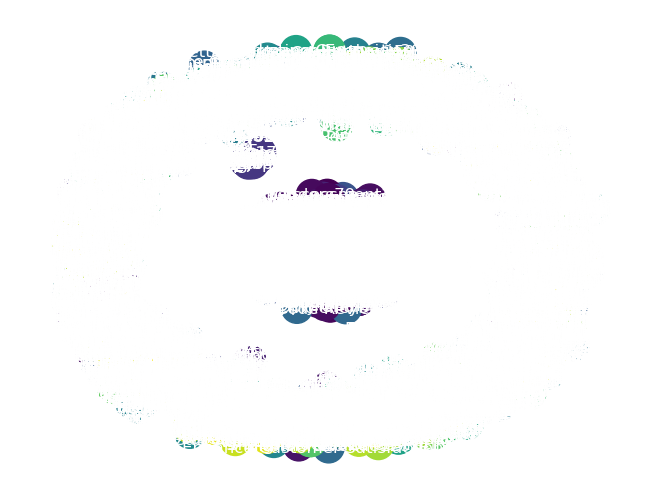

Community assignments: {'Person1': 0, 'Analyst1': 0, 'HR': 1, 'Improve Efficiency1': 0, 'Higher Revenue1': 0, 'Annual Conference1': 0, 'Leadership1': 0, 'Marketing Campaign1': 0, 'Quality Assurance1': 0, 'Risk Assessment1': 0, 'Ticketing System1': 0, 'Clients1': 0, 'Problem Solving': 0, 'Analyst203': 0, 'Manager150': 0, 'Leadership': 95, 'Innovate Products1': 3, 'Improve Efficiency326': 3, 'Better Customer Ratings1': 4, 'Increase Sales1': 4, 'Financial Reporting1': 5, 'Marketing Campaign171': 5, 'Regulators1': 6, 'Vendors71': 6, 'Coordinator1': 7, 'Director294': 7, 'Person2': 8, 'Specialist2': 8, 'Operations': 9, 'Reduce Costs2': 8, 'Increased Productivity2': 8, 'Monthly Planning2': 8, 'Leadership2': 8, 'Agile Development2': 8, 'Quality Assurance2': 8, 'Code Review2': 10, 'CRM2': 8, 'Shareholders2': 8, 'Innovate Products2': 8, 'Analysis': 8, 'Director15': 8, 'Manager388': 11, 'Marketing Campaign2': 10, 'Increase Sales2': 12, 'Improve Efficiency76': 12, 'Higher Revenue2': 8, 'Marketing 

In [10]:

import community.community_louvain as community_louvain
partition = community_louvain.best_partition(G)

# Draw the graph with community-based node coloring
pos = nx.spring_layout(G)  # Position nodes using the spring layout algorithm

# Color nodes based on their community
cmap = plt.get_cmap('viridis')  # Colormap for the communities
unique_communities = list(set(partition.values()))
colors = [cmap(i / len(unique_communities)) for i in range(len(unique_communities))]

# Assign colors to nodes
node_colors = [colors[partition[node]] for node in G.nodes()]

# Draw the network
nx.draw(G, pos, node_color=node_colors, with_labels=True, node_size=500, font_color='white')

# Show the plot
plt.show()

# Print community partitions
print("Community assignments:", partition)

In [12]:
plt.savefig("community_graph.png", format="png")

<Figure size 640x480 with 0 Axes>

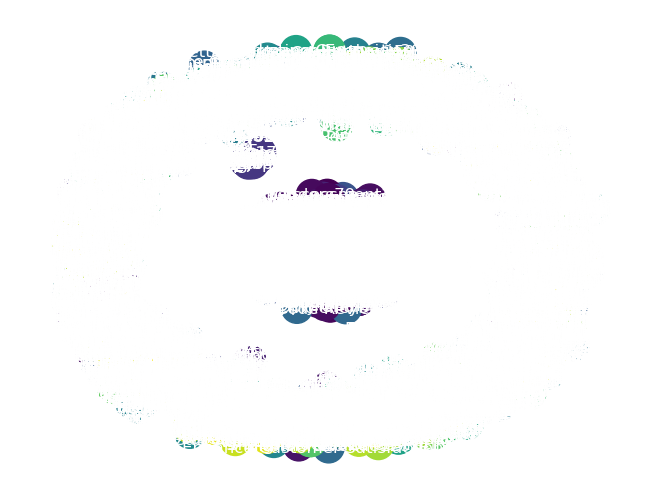

Community assignments: {'Person1': 0, 'Analyst1': 0, 'HR': 1, 'Improve Efficiency1': 0, 'Higher Revenue1': 0, 'Annual Conference1': 0, 'Leadership1': 0, 'Marketing Campaign1': 0, 'Quality Assurance1': 0, 'Risk Assessment1': 0, 'Ticketing System1': 0, 'Clients1': 0, 'Problem Solving': 0, 'Analyst203': 0, 'Manager150': 0, 'Leadership': 95, 'Innovate Products1': 3, 'Improve Efficiency326': 3, 'Better Customer Ratings1': 4, 'Increase Sales1': 4, 'Financial Reporting1': 5, 'Marketing Campaign171': 5, 'Regulators1': 6, 'Vendors71': 6, 'Coordinator1': 7, 'Director294': 7, 'Person2': 8, 'Specialist2': 8, 'Operations': 9, 'Reduce Costs2': 8, 'Increased Productivity2': 8, 'Monthly Planning2': 8, 'Leadership2': 8, 'Agile Development2': 8, 'Quality Assurance2': 8, 'Code Review2': 10, 'CRM2': 8, 'Shareholders2': 8, 'Innovate Products2': 8, 'Analysis': 8, 'Director15': 8, 'Manager388': 11, 'Marketing Campaign2': 10, 'Increase Sales2': 12, 'Improve Efficiency76': 12, 'Higher Revenue2': 8, 'Marketing 

In [17]:
cmap = plt.get_cmap('viridis')  # Colormap for the communities
unique_communities = list(set(partition.values()))
colors = [cmap(i / len(unique_communities)) for i in range(len(unique_communities))]

# Assign colors to nodes
node_colors = [colors[partition[node]] for node in G.nodes()]

# Draw the network
nx.draw(G, pos, node_color=node_colors, with_labels=True, node_size=500, font_color='white')
plt.savefig("community_graph.png", format="png")
# Show the plot
plt.show()

# Print community partitions
print("Community assignments:", partition)

In [23]:
G.degree()

DegreeView({'Person1': 2, 'Representative1': 15, 'Sales': 8, 'Reduce Costs1': 1, 'Better Customer Ratings1': 2, 'Weekly Review1': 1, 'Development1': 1, 'Financial Reporting1': 1, 'Risk Assessment1': 1, 'Quality Assurance1': 2, 'CRM1': 1, 'Clients1': 1, 'Creativity': 11, 'Coordinator12': 1, 'Manager39': 1, 'Problem Solving': 14, 'Marketing Campaign1': 1, 'Innovate Products1': 1, 'Increase Sales29': 1, 'Improve Efficiency1': 1, 'Supply Chain1': 2, 'Agile Development35': 2, 'Regulators1': 2, 'Shareholders7': 1, 'Manager12': 1, 'Person2': 2, 'Engineer2': 15, 'Finance': 6, 'Increase Sales2': 1, 'Increased Productivity2': 1, 'Monthly Planning2': 1, 'Support2': 1, 'Marketing Campaign2': 2, 'Code Review2': 1, 'Performance Evaluation2': 2, 'Ticketing System2': 1, 'Partners2': 2, 'Leadership': 17, 'Director14': 1, 'Coordinator46': 1, 'Improve Efficiency2': 2, 'Improve Efficiency8': 2, 'Higher Revenue2': 1, 'Financial Reporting2': 1, 'Supply Chain8': 2, 'Clients2': 2, 'Vendors24': 2, 'Coordinator

In [24]:
nx.closeness_centrality(G)

{'Person1': 0.17004171221872713,
 'Representative1': 0.1745540565992945,
 'Sales': 0.2013204656530901,
 'Reduce Costs1': 0.14293306674527595,
 'Better Customer Ratings1': 0.14299647981836613,
 'Weekly Review1': 0.14293306674527595,
 'Development1': 0.14293306674527595,
 'Financial Reporting1': 0.14293306674527595,
 'Risk Assessment1': 0.14293306674527595,
 'Quality Assurance1': 0.14299647981836613,
 'CRM1': 0.14293306674527595,
 'Clients1': 0.14293306674527595,
 'Creativity': 0.18534448850523133,
 'Coordinator12': 0.14293306674527595,
 'Manager39': 0.14293306674527595,
 'Problem Solving': 0.2048389358186192,
 'Marketing Campaign1': 0.12105692601336987,
 'Innovate Products1': 0.0009633911368015414,
 'Increase Sales29': 0.0009633911368015414,
 'Improve Efficiency1': 0.12105692601336987,
 'Supply Chain1': 0.002167630057803468,
 'Agile Development35': 0.002167630057803468,
 'Regulators1': 0.0019267822736030828,
 'Shareholders7': 0.0012845215157353885,
 'Manager12': 0.14293306674527595,
 'P

In [31]:
!pip install pyvis

   ---------------------------------------- 0.0/756.0 kB ? eta -:--:--
    --------------------------------------- 10.2/756.0 kB ? eta -:--:--
   ---------- ----------------------------- 194.6/756.0 kB 3.0 MB/s eta 0:00:01
   ---------------------------------------- 756.0/756.0 kB 6.8 MB/s eta 0:00:00
   ---------------------------------------- 0.0/42.4 kB ? eta -:--:--
   ---------------------------------------- 42.4/42.4 kB ? eta 0:00:00


In [40]:
import random
import networkx as nx
from pyvis.network import Network

# Initialize the PyVis network
net = Network(notebook=True, height="750px", width="100%", bgcolor="#222222", font_color="white")

# Sample data for 50 employees
departments = ["GA", "Sales", "Engineering"]
managers = ["Manager_A", "Manager_B", "Manager_C", "Manager_D", "Manager_E"]
skills = ["Python", "Data Analysis", "Project Management", "Salesforce", "Java", "Excel", "SQL", "Cloud Computing"]
projects = ["Project_X", "Project_Y", "Project_Z", "Project_A", "Project_B"]

# Create 50 employees
employee_ids = [f"Employee_{i}" for i in range(1, 51)]

# Add nodes for employees, departments, managers, skills, and projects
for employee in employee_ids:
    net.add_node(employee, label=employee, title=employee, color="lightblue", shape="dot")

for department in departments:
    net.add_node(department, label=department, title="Department", color="orange", shape="ellipse")

for manager in managers:
    net.add_node(manager, label=manager, title="Manager", color="red", shape="ellipse")

for skill in skills:
    net.add_node(skill, label=skill, title="Skill", color="green", shape="ellipse")

for project in projects:
    net.add_node(project, label=project, title="Project", color="purple", shape="ellipse")

# Assign each employee to a random department, manager, two random skills, and two projects
for employee in employee_ids:
    department = random.choice(departments)
    manager = random.choice(managers)
    employee_skills = random.sample(skills, 2)
    employee_projects = random.sample(projects, 2)

    # Add edges for relationships
    net.add_edge(employee, department, label="belongs_to", color="gray")
    net.add_edge(employee, manager, label="reports_to", color="gray")
    
    for skill in employee_skills:
        net.add_edge(employee, skill, label="has_skill", color="blue")
    
    for project in employee_projects:
        net.add_edge(employee, project, label="works_on", color="green")

# Add an option to interactively filter by selecting specific employees
# PyVis allows this interaction by default via its HTML output

# Save and visualize the graph
net.set_options('''
var options = {
  "nodes": {
    "shape": "dot",
    "size": 15
  },
  "edges": {
    "color": {
      "inherit": true
    },
    "smooth": {
      "type": "continuous"
    }
  },
  "interaction": {
    "navigationButtons": true,
    "keyboard": true
  },
  "physics": {
    "barnesHut": {
      "gravitationalConstant": -20000,
      "centralGravity": 0.3,
      "springLength": 95
    }
  }
}
''')

# Save the interactive graph to an HTML file
net.show("employee_knowledge_graph.html")

employee_knowledge_graph.html


In [42]:
import random
import networkx as nx
from pyvis.network import Network

# Initialize the PyVis network (set notebook=False if running outside Jupyter)
net = Network(notebook=True, height="750px", width="100%", bgcolor="#222222", font_color="white")

# Sample data for 50 employees
departments = ["GA", "Sales", "Engineering"]
managers = ["Manager_A", "Manager_B", "Manager_C", "Manager_D", "Manager_E"]
skills = ["Python", "Data Analysis", "Project Management", "Salesforce", "Java", "Excel", "SQL", "Cloud Computing"]
projects = ["Project_X", "Project_Y", "Project_Z", "Project_A", "Project_B"]

# Create 50 employees
employee_ids = [f"Employee_{i}" for i in range(1, 51)]

# Add nodes for employees, departments, managers, skills, and projects
for employee in employee_ids:
    net.add_node(employee, label=employee, title=employee, color="lightblue", shape="dot")

for department in departments:
    net.add_node(department, label=department, title="Department", color="orange", shape="ellipse")

for manager in managers:
    net.add_node(manager, label=manager, title="Manager", color="red", shape="ellipse")

for skill in skills:
    net.add_node(skill, label=skill, title="Skill", color="green", shape="ellipse")

for project in projects:
    net.add_node(project, label=project, title="Project", color="purple", shape="ellipse")

# Assign each employee to a random department, manager, two random skills, and two projects
for employee in employee_ids:
    department = random.choice(departments)
    manager = random.choice(managers)
    employee_skills = random.sample(skills, 2)
    employee_projects = random.sample(projects, 2)

    # Add edges for relationships
    net.add_edge(employee, department, label="belongs_to", color="gray")
    net.add_edge(employee, manager, label="reports_to", color="gray")
    
    for skill in employee_skills:
        net.add_edge(employee, skill, label="has_skill", color="blue")
    
    for project in employee_projects:
        net.add_edge(employee, project, label="works_on", color="green")

# Set interactive options, now fully corrected without hideEdgesOnDrag
net.set_options('''
{
  "nodes": {
    "shape": "dot",
    "size": 16
  },
  "edges": {
    "smooth": {
      "enabled": true,
      "type": "continuous"
    }
  },
  "interaction": {
    "navigationButtons": true,
    "keyboard": {
      "enabled": true
    },
    "hover": true,
    "tooltipDelay": 100
  },
  "manipulation": {
    "enabled": true
  },
  "physics": {
    "barnesHut": {
      "gravitationalConstant": -20000,
      "centralGravity": 0.1,
      "springLength": 100
    },
    "minVelocity": 0.75
  },
  "highlightNearest": {
    "enabled": true,
    "degree": 1,
    "hover": false,
    "hideColor": "rgba(200,200,200,0.1)"
  }
}
''')

# Save and visualize the graph as an interactive HTML file
net.show("interactive_employee_graph.html")


interactive_employee_graph.html


C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\3681750506.py:63: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



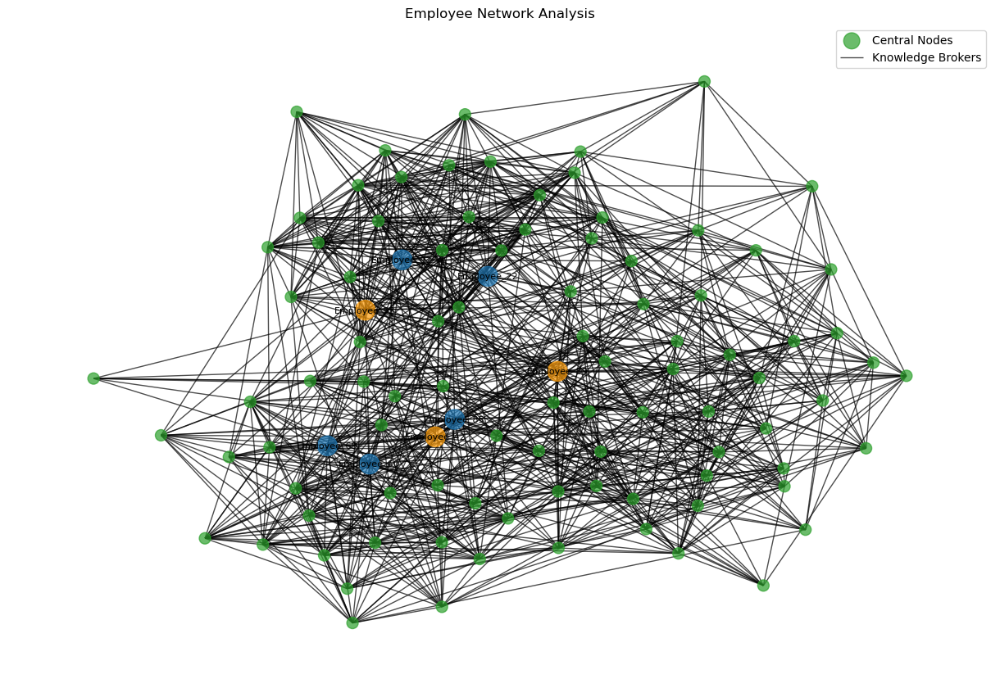

Central Nodes (High Degree Centrality):
Employee_22 - Department: Marketing
Employee_69 - Department: HR
Employee_85 - Department: HR
Employee_92 - Department: Marketing
Employee_60 - Department: HR

Knowledge Brokers (High Betweenness Centrality):
Employee_85 - Department: HR
Employee_93 - Department: Marketing
Employee_69 - Department: HR
Employee_39 - Department: Finance
Employee_42 - Department: HR


In [45]:
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np

# Generate synthetic employee data
def generate_employees(num_employees):
    departments = ['HR', 'IT', 'Finance', 'Marketing', 'Sales', 'Operations']
    employees = []
    for i in range(num_employees):
        employee = {
            'id': i,
            'name': f'Employee_{i}',
            'department': random.choice(departments),
            'years_experience': random.randint(1, 20)
        }
        employees.append(employee)
    return employees

# Create graph from employee data
def create_employee_graph(employees):
    G = nx.Graph()
    for employee in employees:
        G.add_node(employee['id'], **employee)
    
    # Create edges based on department and random connections
    for i in range(len(employees)):
        for j in range(i+1, len(employees)):
            if employees[i]['department'] == employees[j]['department']:
                if random.random() < 0.7:  # 70% chance of connection within department
                    G.add_edge(i, j)
            elif random.random() < 0.1:  # 10% chance of connection outside department
                G.add_edge(i, j)
    
    return G

# Analyze and visualize the network
def analyze_and_visualize_network(G):
    # Calculate centrality measures
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    
    # Identify central nodes and knowledge brokers
    central_nodes = sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:5]
    knowledge_brokers = sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:5]
    
    # Prepare node colors and sizes
    node_colors = ['#1f77b4' if node in central_nodes else '#ff9f0e' if node in knowledge_brokers else '#2ca02c' for node in G.nodes()]
    node_sizes = [300 if node in central_nodes or node in knowledge_brokers else 100 for node in G.nodes()]
    
    # Plot the graph
    pos = nx.spring_layout(G)
    plt.figure(figsize=(12, 8))
    nx.draw(G, pos, node_color=node_colors, node_size=node_sizes, with_labels=False, alpha=0.7)
    
    # Add labels for central nodes and knowledge brokers
    labels = {node: G.nodes[node]['name'] for node in central_nodes + knowledge_brokers}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)
    
    plt.title("Employee Network Analysis")
    plt.legend(["Central Nodes", "Knowledge Brokers"])
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    print("Central Nodes (High Degree Centrality):")
    for node in central_nodes:
        print(f"{G.nodes[node]['name']} - Department: {G.nodes[node]['department']}")
    
    print("\nKnowledge Brokers (High Betweenness Centrality):")
    for node in knowledge_brokers:
        print(f"{G.nodes[node]['name']} - Department: {G.nodes[node]['department']}")

# Main execution
num_employees = 100
employees = generate_employees(num_employees)
G = create_employee_graph(employees)
analyze_and_visualize_network(G)

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\3882856780.py:53: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\3882856780.py:68: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



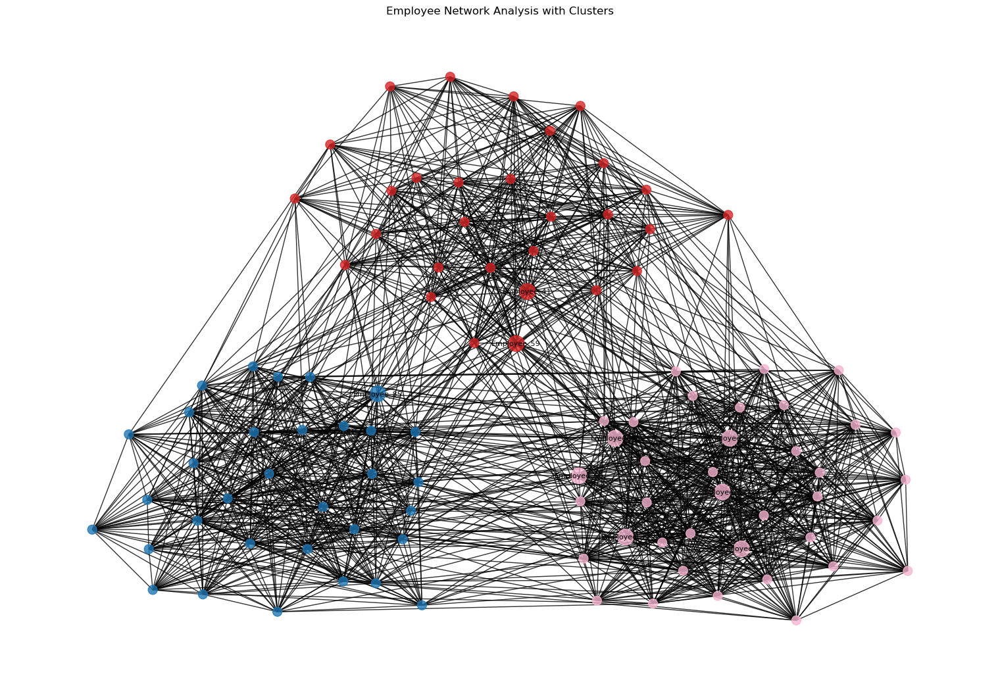

Central Nodes (High Degree Centrality):
Employee_19 - Department: SALES - Cluster: 2
Employee_37 - Department: SALES - Cluster: 2
Employee_45 - Department: SALES - Cluster: 2
Employee_47 - Department: SALES - Cluster: 2
Employee_39 - Department: SALES - Cluster: 2

Knowledge Brokers (High Betweenness Centrality):
Employee_66 - Department: SALES - Cluster: 2
Employee_85 - Department: GA - Cluster: 0
Employee_41 - Department: ENGINEERING - Cluster: 1
Employee_47 - Department: SALES - Cluster: 2
Employee_59 - Department: ENGINEERING - Cluster: 1

Cluster Analysis:

Cluster 2 - Size: 38
Department Distribution:
  SALES: 38 (100.0%)

Cluster 0 - Size: 33
Department Distribution:
  GA: 33 (100.0%)

Cluster 1 - Size: 29
Department Distribution:
  ENGINEERING: 29 (100.0%)


In [47]:
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np
from community import community_louvain

# Generate synthetic employee data
def generate_employees(num_employees):
    departments = ['GA', 'SALES', 'ENGINEERING']
    employees = []
    for i in range(num_employees):
        employee = {
            'id': i,
            'name': f'Employee_{i}',
            'department': random.choice(departments),
            'years_experience': random.randint(1, 20)
        }
        employees.append(employee)
    return employees

# Create graph from employee data
def create_employee_graph(employees):
    G = nx.Graph()
    for employee in employees:
        G.add_node(employee['id'], **employee)
    
    # Create edges based on department and random connections
    for i in range(len(employees)):
        for j in range(i+1, len(employees)):
            if employees[i]['department'] == employees[j]['department']:
                if random.random() < 0.7:  # 70% chance of connection within department
                    G.add_edge(i, j)
            elif random.random() < 0.1:  # 10% chance of connection outside department
                G.add_edge(i, j)
    
    return G

# Analyze and visualize the network with clusters
def analyze_and_visualize_network(G):
    # Calculate centrality measures
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    
    # Identify central nodes and knowledge brokers
    central_nodes = sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:5]
    knowledge_brokers = sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:5]
    
    # Perform cluster analysis using Louvain method
    partition = community_louvain.best_partition(G)
    
    # Prepare node colors based on clusters and sizes based on centrality
    num_clusters = len(set(partition.values()))
    color_map = plt.cm.get_cmap('tab20')
    node_colors = [color_map(partition[node] / num_clusters) for node in G.nodes()]
    node_sizes = [300 if node in central_nodes or node in knowledge_brokers else 100 for node in G.nodes()]
    
    # Plot the graph
    pos = nx.spring_layout(G)
    plt.figure(figsize=(15, 10))
    nx.draw(G, pos, node_color=node_colors, node_size=node_sizes, with_labels=False, alpha=0.8)
    
    # Add labels for central nodes and knowledge brokers
    labels = {node: G.nodes[node]['name'] for node in central_nodes + knowledge_brokers}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)
    
    plt.title("Employee Network Analysis with Clusters")
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    print("Central Nodes (High Degree Centrality):")
    for node in central_nodes:
        print(f"{G.nodes[node]['name']} - Department: {G.nodes[node]['department']} - Cluster: {partition[node]}")
    
    print("\nKnowledge Brokers (High Betweenness Centrality):")
    for node in knowledge_brokers:
        print(f"{G.nodes[node]['name']} - Department: {G.nodes[node]['department']} - Cluster: {partition[node]}")
    
    # Analyze clusters
    cluster_sizes = {}
    cluster_departments = {}
    for node, cluster in partition.items():
        cluster_sizes[cluster] = cluster_sizes.get(cluster, 0) + 1
        dept = G.nodes[node]['department']
        if cluster not in cluster_departments:
            cluster_departments[cluster] = {}
        cluster_departments[cluster][dept] = cluster_departments[cluster].get(dept, 0) + 1
    
    print("\nCluster Analysis:")
    for cluster, size in sorted(cluster_sizes.items(), key=lambda x: x[1], reverse=True):
        print(f"\nCluster {cluster} - Size: {size}")
        print("Department Distribution:")
        for dept, count in sorted(cluster_departments[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {dept}: {count} ({count/size*100:.1f}%)")

# Main execution
num_employees = 100
employees = generate_employees(num_employees)
G = create_employee_graph(employees)
analyze_and_visualize_network(G)

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\592777836.py:53: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



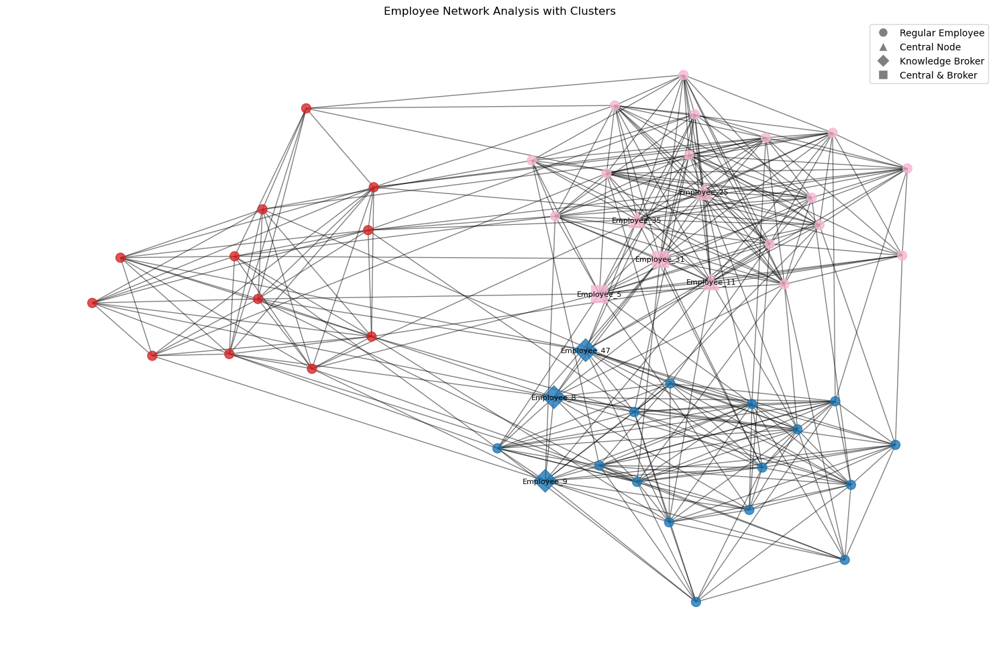

Central Nodes (High Degree Centrality):
Employee_35 - Department: GA - Cluster: 2
Employee_5 - Department: GA - Cluster: 2
Employee_11 - Department: GA - Cluster: 2
Employee_25 - Department: GA - Cluster: 2
Employee_31 - Department: GA - Cluster: 2

Knowledge Brokers (High Betweenness Centrality):
Employee_5 - Department: GA - Cluster: 2
Employee_8 - Department: ENGINEERING - Cluster: 0
Employee_9 - Department: ENGINEERING - Cluster: 0
Employee_47 - Department: ENGINEERING - Cluster: 0
Employee_31 - Department: GA - Cluster: 2

Cluster Analysis:

Cluster 2 - Size: 20
Department Distribution:
  GA: 20 (100.0%)

Cluster 0 - Size: 18
Department Distribution:
  ENGINEERING: 18 (100.0%)

Cluster 1 - Size: 12
Department Distribution:
  SALES: 12 (100.0%)


In [49]:
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np
from community import community_louvain
from matplotlib.lines import Line2D

# Generate synthetic employee data
def generate_employees(num_employees):
    departments = ['GA', 'SALES', 'ENGINEERING']
    employees = []
    for i in range(num_employees):
        employee = {
            'id': i,
            'name': f'Employee_{i}',
            'department': random.choice(departments),
            'years_experience': random.randint(1, 20)
        }
        employees.append(employee)
    return employees

# Create graph from employee data
def create_employee_graph(employees):
    G = nx.Graph()
    for employee in employees:
        G.add_node(employee['id'], **employee)
    
    for i in range(len(employees)):
        for j in range(i+1, len(employees)):
            if employees[i]['department'] == employees[j]['department']:
                if random.random() < 0.7:  # 70% chance of connection within department
                    G.add_edge(i, j)
            elif random.random() < 0.1:  # 10% chance of connection outside department
                G.add_edge(i, j)
    
    return G

# Analyze and visualize the network with clusters
def analyze_and_visualize_network(G):
    # Calculate centrality measures
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    
    # Identify central nodes and knowledge brokers
    central_nodes = set(sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:5])
    knowledge_brokers = set(sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:5])
    
    # Perform cluster analysis using Louvain method
    partition = community_louvain.best_partition(G)
    
    # Prepare node colors based on clusters
    num_clusters = len(set(partition.values()))
    color_map = plt.cm.get_cmap('tab20')
    node_colors = [color_map(partition[node] / num_clusters) for node in G.nodes()]
    
    # Prepare node sizes and shapes based on centrality and brokerage
    node_sizes = []
    node_shapes = []
    for node in G.nodes():
        size = 300 if node in central_nodes or node in knowledge_brokers else 100
        node_sizes.append(size)
        if node in central_nodes and node in knowledge_brokers:
            node_shapes.append('s')  # square for both
        elif node in central_nodes:
            node_shapes.append('^')  # triangle for central nodes
        elif node in knowledge_brokers:
            node_shapes.append('D')  # diamond for knowledge brokers
        else:
            node_shapes.append('o')  # circle for regular nodes
    
    # Plot the graph
    pos = nx.spring_layout(G)
    plt.figure(figsize=(15, 10))
    
    # Draw nodes
    for shape in set(node_shapes):
        node_list = [node for node, node_shape in enumerate(node_shapes) if node_shape == shape]
        nx.draw_networkx_nodes(G, pos, nodelist=node_list, node_color=[node_colors[i] for i in node_list],
                               node_size=[node_sizes[i] for i in node_list], node_shape=shape, alpha=0.8)
    
    # Draw edges
    nx.draw_networkx_edges(G, pos, alpha=0.5)
    
    # Add labels for central nodes and knowledge brokers
    labels = {node: G.nodes[node]['name'] for node in central_nodes.union(knowledge_brokers)}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)
    
    plt.title("Employee Network Analysis with Clusters")
    
    # Create legend
    legend_elements = [
        Line2D([0], [0], marker='o', color='w', label='Regular Employee', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='^', color='w', label='Central Node', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='D', color='w', label='Knowledge Broker', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='s', color='w', label='Central & Broker', markerfacecolor='gray', markersize=10)
    ]
    plt.legend(handles=legend_elements, loc='upper right')
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    print("Central Nodes (High Degree Centrality):")
    for node in central_nodes:
        print(f"{G.nodes[node]['name']} - Department: {G.nodes[node]['department']} - Cluster: {partition[node]}")
    
    print("\nKnowledge Brokers (High Betweenness Centrality):")
    for node in knowledge_brokers:
        print(f"{G.nodes[node]['name']} - Department: {G.nodes[node]['department']} - Cluster: {partition[node]}")
    
    # Analyze clusters
    cluster_sizes = {}
    cluster_departments = {}
    for node, cluster in partition.items():
        cluster_sizes[cluster] = cluster_sizes.get(cluster, 0) + 1
        dept = G.nodes[node]['department']
        if cluster not in cluster_departments:
            cluster_departments[cluster] = {}
        cluster_departments[cluster][dept] = cluster_departments[cluster].get(dept, 0) + 1
    
    print("\nCluster Analysis:")
    for cluster, size in sorted(cluster_sizes.items(), key=lambda x: x[1], reverse=True):
        print(f"\nCluster {cluster} - Size: {size}")
        print("Department Distribution:")
        for dept, count in sorted(cluster_departments[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {dept}: {count} ({count/size*100:.1f}%)")

# Main execution
num_employees = 50
employees = generate_employees(num_employees)
G = create_employee_graph(employees)
analyze_and_visualize_network(G)

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\4251624238.py:57: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



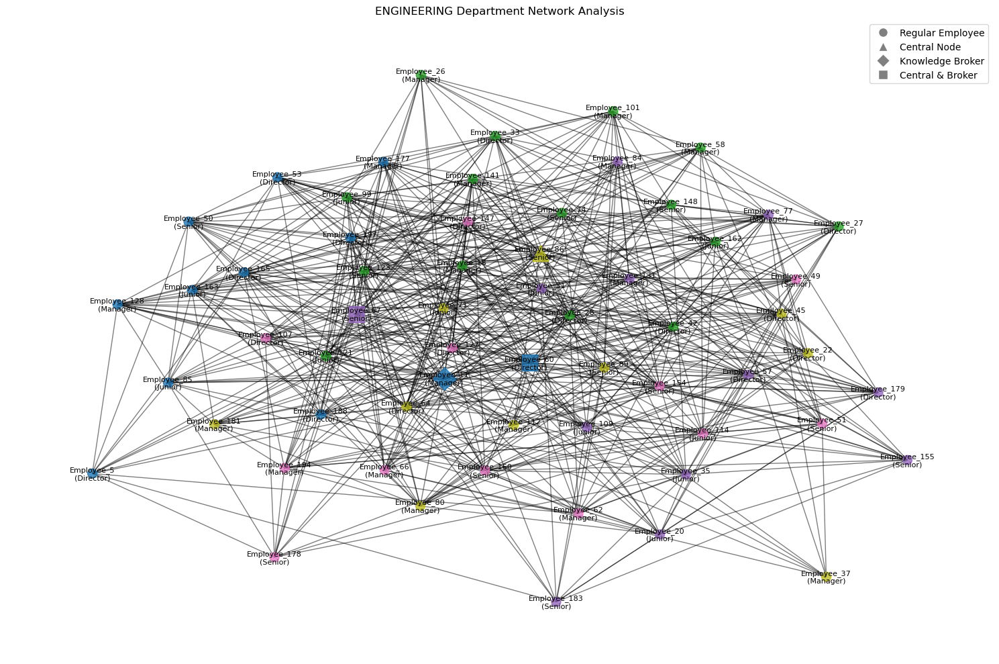


ENGINEERING Department Analysis:

Central Nodes (High Degree Centrality):
Employee_67 - Role: Senior - Years: 11
Employee_60 - Role: Director - Years: 19
Employee_86 - Role: Senior - Years: 17

Knowledge Brokers (High Betweenness Centrality):
Employee_67 - Role: Senior - Years: 11
Employee_11 - Role: Manager - Years: 14
Employee_60 - Role: Director - Years: 19

Cluster Analysis:

Cluster 1 - Size: 15
Role Distribution:
  Manager: 5 (33.3%)
  Director: 4 (26.7%)
  Senior: 3 (20.0%)
  Junior: 3 (20.0%)

Cluster 0 - Size: 12
Role Distribution:
  Director: 6 (50.0%)
  Manager: 3 (25.0%)
  Junior: 2 (16.7%)
  Senior: 1 (8.3%)

Cluster 2 - Size: 12
Role Distribution:
  Junior: 4 (33.3%)
  Senior: 3 (25.0%)
  Manager: 3 (25.0%)
  Director: 2 (16.7%)

Cluster 3 - Size: 12
Role Distribution:
  Senior: 5 (41.7%)
  Manager: 3 (25.0%)
  Director: 3 (25.0%)
  Junior: 1 (8.3%)

Cluster 4 - Size: 10
Role Distribution:
  Manager: 4 (40.0%)
  Director: 3 (30.0%)
  Senior: 2 (20.0%)
  Junior: 1 (10.0%)

In [52]:
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np
from community import community_louvain
from matplotlib.lines import Line2D

def generate_employees(num_employees):
    departments = ['GA', 'SALES', 'ENGINEERING']
    employees = []
    for i in range(num_employees):
        employee = {
            'id': i,
            'name': f'Employee_{i}',
            'department': random.choice(departments),
            'years_experience': random.randint(1, 20),
            'role': random.choice(['Junior', 'Senior', 'Manager', 'Director'])
        }
        employees.append(employee)
    return employees

def create_department_graph(employees, target_department):
    dept_employees = [e for e in employees if e['department'] == target_department]
    G = nx.Graph()
    for employee in dept_employees:
        G.add_node(employee['id'], **employee)
    
    # Ensure each node has at least one connection
    node_ids = list(G.nodes())
    for node in node_ids:
        if G.degree(node) == 0:
            other_node = random.choice([n for n in node_ids if n != node])
            G.add_edge(node, other_node)
    
    # Add more random connections
    for i in range(len(dept_employees)):
        for j in range(i+1, len(dept_employees)):
            if random.random() < 0.3:  # 30% chance of additional connection
                G.add_edge(dept_employees[i]['id'], dept_employees[j]['id'])
    
    return G

def analyze_and_visualize_department_network(G, department):
    if len(G) == 0:
        print(f"No employees found in the {department} department.")
        return

    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    
    central_nodes = set(sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:3])
    knowledge_brokers = set(sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:3])
    
    partition = community_louvain.best_partition(G)
    
    num_clusters = len(set(partition.values()))
    color_map = plt.cm.get_cmap('tab20')
    node_colors = [color_map(partition[node] / num_clusters) for node in G.nodes()]
    
    node_sizes = []
    node_shapes = []
    for node in G.nodes():
        size = 300 if node in central_nodes or node in knowledge_brokers else 100
        node_sizes.append(size)
        if node in central_nodes and node in knowledge_brokers:
            node_shapes.append('s')  # square for both
        elif node in central_nodes:
            node_shapes.append('^')  # triangle for central nodes
        elif node in knowledge_brokers:
            node_shapes.append('D')  # diamond for knowledge brokers
        else:
            node_shapes.append('o')  # circle for regular nodes
    
    pos = nx.spring_layout(G, k=0.5, iterations=50)  # Adjust layout parameters
    plt.figure(figsize=(15, 10))
    
    for shape in set(node_shapes):
        node_list = [node for node, node_shape in zip(G.nodes(), node_shapes) if node_shape == shape]
        nx.draw_networkx_nodes(G, pos, nodelist=node_list, node_color=[node_colors[list(G.nodes()).index(n)] for n in node_list],
                               node_size=[node_sizes[list(G.nodes()).index(n)] for n in node_list], node_shape=shape, alpha=0.8)
    
    nx.draw_networkx_edges(G, pos, alpha=0.5)
    
    labels = {node: f"{G.nodes[node]['name']}\n({G.nodes[node]['role']})" for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)
    
    plt.title(f"{department} Department Network Analysis")
    
    legend_elements = [
        Line2D([0], [0], marker='o', color='w', label='Regular Employee', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='^', color='w', label='Central Node', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='D', color='w', label='Knowledge Broker', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='s', color='w', label='Central & Broker', markerfacecolor='gray', markersize=10)
    ]
    plt.legend(handles=legend_elements, loc='upper right')
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    print(f"\n{department} Department Analysis:")
    print("\nCentral Nodes (High Degree Centrality):")
    for node in central_nodes:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']}")
    
    print("\nKnowledge Brokers (High Betweenness Centrality):")
    for node in knowledge_brokers:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']}")
    
    print("\nCluster Analysis:")
    cluster_sizes = {}
    cluster_roles = {}
    for node, cluster in partition.items():
        cluster_sizes[cluster] = cluster_sizes.get(cluster, 0) + 1
        role = G.nodes[node]['role']
        if cluster not in cluster_roles:
            cluster_roles[cluster] = {}
        cluster_roles[cluster][role] = cluster_roles[cluster].get(role, 0) + 1
    
    for cluster, size in sorted(cluster_sizes.items(), key=lambda x: x[1], reverse=True):
        print(f"\nCluster {cluster} - Size: {size}")
        print("Role Distribution:")
        for role, count in sorted(cluster_roles[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {role}: {count} ({count/size*100:.1f}%)")

# Main execution
num_employees = 200
employees = generate_employees(num_employees)

# Select a department for analysis
target_department = 'ENGINEERING'  # You can change this to any department

G = create_department_graph(employees, target_department)
analyze_and_visualize_department_network(G, target_department)

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\592777836.py:53: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



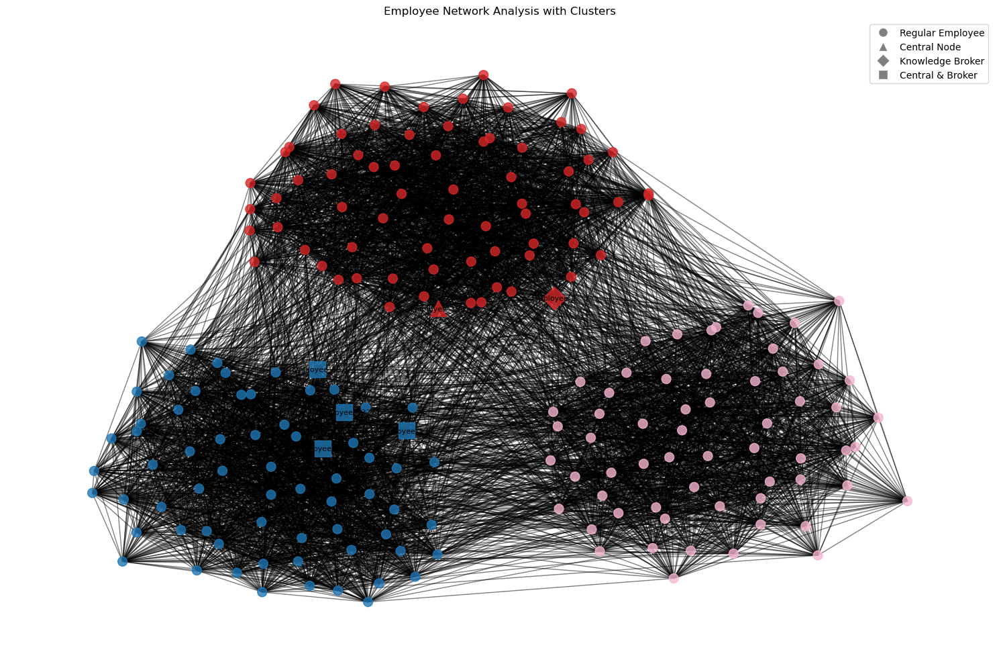

Central Nodes (High Degree Centrality):
Employee_199 - Department: GA - Cluster: 1
Employee_137 - Department: SALES - Cluster: 0
Employee_174 - Department: SALES - Cluster: 0
Employee_175 - Department: SALES - Cluster: 0
Employee_83 - Department: SALES - Cluster: 0

Knowledge Brokers (High Betweenness Centrality):
Employee_1 - Department: GA - Cluster: 1
Employee_137 - Department: SALES - Cluster: 0
Employee_174 - Department: SALES - Cluster: 0
Employee_175 - Department: SALES - Cluster: 0
Employee_83 - Department: SALES - Cluster: 0

Cluster Analysis:

Cluster 1 - Size: 71
Department Distribution:
  GA: 71 (100.0%)

Cluster 0 - Size: 68
Department Distribution:
  SALES: 68 (100.0%)

Cluster 2 - Size: 61
Department Distribution:
  ENGINEERING: 61 (100.0%)


In [53]:
G = create_employee_graph(employees)
analyze_and_visualize_network(G)

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\2664466893.py:76: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



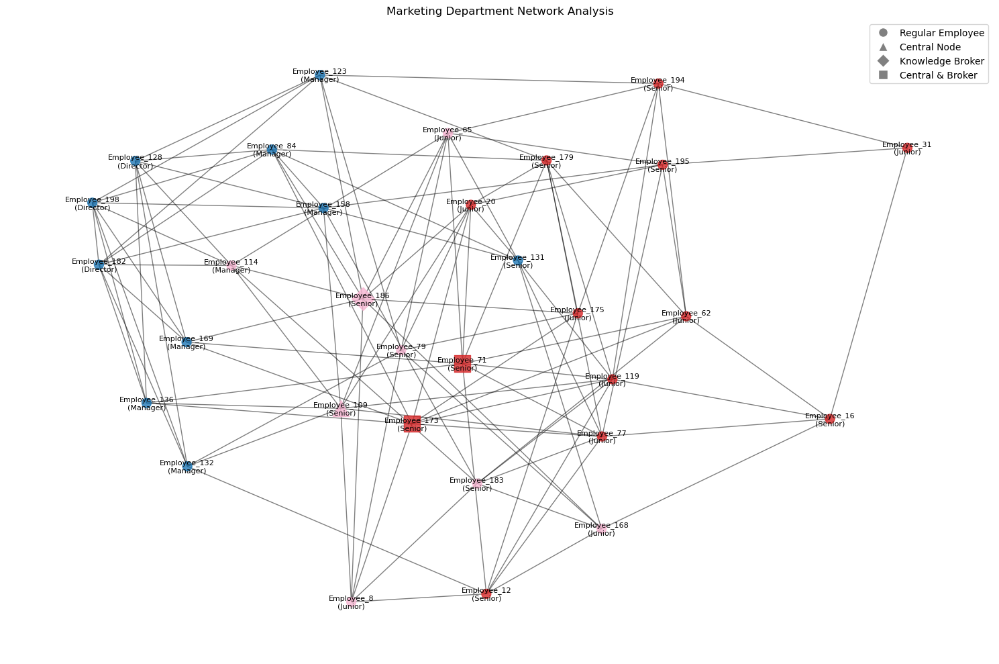


Marketing Department Analysis:

Central Nodes (High Degree Centrality):
Employee_173 - Role: Senior - Years: 15
Employee_109 - Role: Senior - Years: 11
Employee_71 - Role: Senior - Years: 7

Knowledge Brokers (High Betweenness Centrality):
Employee_186 - Role: Senior - Years: 9
Employee_173 - Role: Senior - Years: 15
Employee_71 - Role: Senior - Years: 7

Cluster Analysis:

Cluster 1 - Size: 13
Role Distribution:
  Senior: 7 (53.8%)
  Junior: 6 (46.2%)

Cluster 0 - Size: 10
Role Distribution:
  Manager: 6 (60.0%)
  Director: 3 (30.0%)
  Senior: 1 (10.0%)

Cluster 2 - Size: 8
Role Distribution:
  Senior: 4 (50.0%)
  Junior: 3 (37.5%)
  Manager: 1 (12.5%)


In [54]:
import networkx as nx
import matplotlib.pyplot as plt
import random
from community import community_louvain
from matplotlib.lines import Line2D

def generate_employees(num_employees):
    departments = ['HR', 'IT', 'Finance', 'Marketing', 'Sales', 'Operations']
    roles = ['Junior', 'Senior', 'Manager', 'Director']
    employees = []
    for i in range(num_employees):
        employee = {
            'id': i,
            'name': f'Employee_{i}',
            'department': random.choice(departments),
            'years_experience': random.randint(1, 20),
            'role': random.choices(roles, weights=[4, 3, 2, 1])[0]  # More juniors, fewer directors
        }
        employees.append(employee)
    return employees

def create_department_graph(employees, target_department):
    dept_employees = [e for e in employees if e['department'] == target_department]
    G = nx.Graph()
    
    # Sort employees by role to ensure higher roles are processed first
    dept_employees.sort(key=lambda x: ['Director', 'Manager', 'Senior', 'Junior'].index(x['role']))
    
    for employee in dept_employees:
        G.add_node(employee['id'], **employee)
    
    # Create hierarchical structure
    directors = [e for e in dept_employees if e['role'] == 'Director']
    managers = [e for e in dept_employees if e['role'] == 'Manager']
    seniors = [e for e in dept_employees if e['role'] == 'Senior']
    juniors = [e for e in dept_employees if e['role'] == 'Junior']
    
    # Director to Managers
    for director in directors:
        for manager in managers:
            G.add_edge(director['id'], manager['id'])
    
    # Managers to Seniors
    for manager in managers:
        for senior in random.sample(seniors, min(len(seniors), 3)):  # Each manager oversees up to 3 seniors
            G.add_edge(manager['id'], senior['id'])
    
    # Seniors to Juniors
    for senior in seniors:
        for junior in random.sample(juniors, min(len(juniors), 5)):  # Each senior oversees up to 5 juniors
            G.add_edge(senior['id'], junior['id'])
    
    # Add some cross-role connections (e.g., project collaborations)
    all_employees = directors + managers + seniors + juniors
    for _ in range(len(all_employees) // 2):  # Add 50% more edges for cross-role connections
        emp1, emp2 = random.sample(all_employees, 2)
        if not G.has_edge(emp1['id'], emp2['id']):
            G.add_edge(emp1['id'], emp2['id'])
    
    return G

def analyze_and_visualize_department_network(G, department):
    if len(G) == 0:
        print(f"No employees found in the {department} department.")
        return

    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    
    central_nodes = set(sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:3])
    knowledge_brokers = set(sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:3])
    
    partition = community_louvain.best_partition(G)
    
    num_clusters = len(set(partition.values()))
    color_map = plt.cm.get_cmap('tab20')
    node_colors = [color_map(partition[node] / num_clusters) for node in G.nodes()]
    
    node_sizes = []
    node_shapes = []
    for node in G.nodes():
        size = 300 if node in central_nodes or node in knowledge_brokers else 100
        node_sizes.append(size)
        if node in central_nodes and node in knowledge_brokers:
            node_shapes.append('s')  # square for both
        elif node in central_nodes:
            node_shapes.append('^')  # triangle for central nodes
        elif node in knowledge_brokers:
            node_shapes.append('D')  # diamond for knowledge brokers
        else:
            node_shapes.append('o')  # circle for regular nodes
    
    pos = nx.spring_layout(G, k=0.5, iterations=50)
    plt.figure(figsize=(15, 10))
    
    for shape in set(node_shapes):
        node_list = [node for node, node_shape in zip(G.nodes(), node_shapes) if node_shape == shape]
        nx.draw_networkx_nodes(G, pos, nodelist=node_list, node_color=[node_colors[list(G.nodes()).index(n)] for n in node_list],
                               node_size=[node_sizes[list(G.nodes()).index(n)] for n in node_list], node_shape=shape, alpha=0.8)
    
    nx.draw_networkx_edges(G, pos, alpha=0.5)
    
    labels = {node: f"{G.nodes[node]['name']}\n({G.nodes[node]['role']})" for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)
    
    plt.title(f"{department} Department Network Analysis")
    
    legend_elements = [
        Line2D([0], [0], marker='o', color='w', label='Regular Employee', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='^', color='w', label='Central Node', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='D', color='w', label='Knowledge Broker', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='s', color='w', label='Central & Broker', markerfacecolor='gray', markersize=10)
    ]
    plt.legend(handles=legend_elements, loc='upper right')
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    print(f"\n{department} Department Analysis:")
    print("\nCentral Nodes (High Degree Centrality):")
    for node in central_nodes:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']}")
    
    print("\nKnowledge Brokers (High Betweenness Centrality):")
    for node in knowledge_brokers:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']}")
    
    print("\nCluster Analysis:")
    cluster_sizes = {}
    cluster_roles = {}
    for node, cluster in partition.items():
        cluster_sizes[cluster] = cluster_sizes.get(cluster, 0) + 1
        role = G.nodes[node]['role']
        if cluster not in cluster_roles:
            cluster_roles[cluster] = {}
        cluster_roles[cluster][role] = cluster_roles[cluster].get(role, 0) + 1
    
    for cluster, size in sorted(cluster_sizes.items(), key=lambda x: x[1], reverse=True):
        print(f"\nCluster {cluster} - Size: {size}")
        print("Role Distribution:")
        for role, count in sorted(cluster_roles[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {role}: {count} ({count/size*100:.1f}%)")

# Main execution
num_employees = 200
employees = generate_employees(num_employees)

# Select a department for analysis
target_department = 'Marketing'  # You can change this to any department

G = create_department_graph(employees, target_department)
analyze_and_visualize_department_network(G, target_department)

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\2449964355.py:197: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



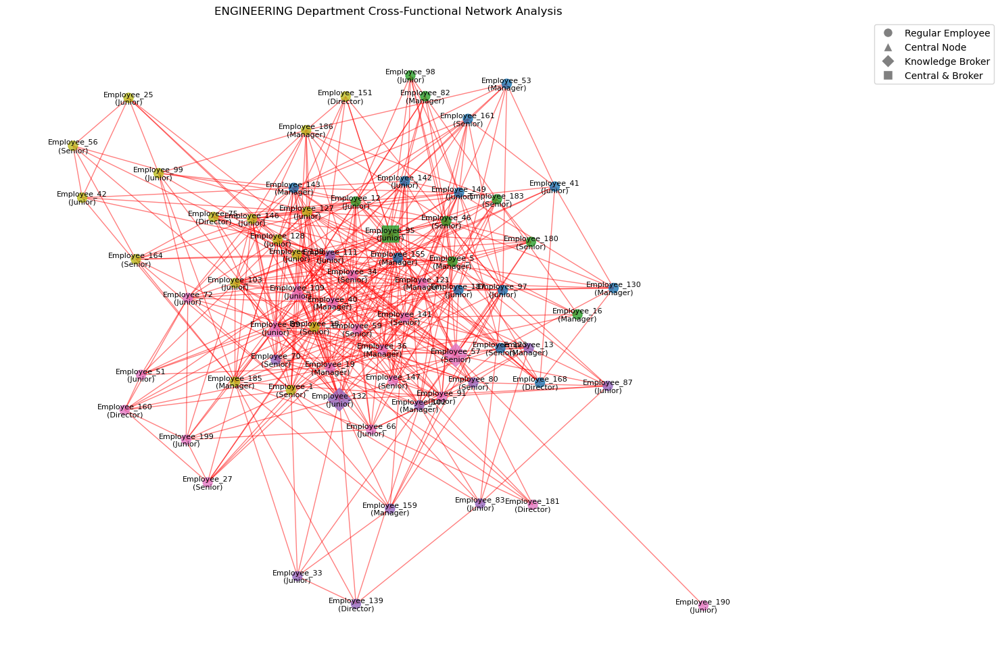


ENGINEERING Department Cross-Functional Network Analysis:

Central Nodes (High Degree Centrality):
Employee_89 - Role: Junior - Years: 17 - Skills: Communication, Analytical, Leadership
Employee_109 - Role: Junior - Years: 1 - Skills: Analytical, Leadership, Communication
Employee_95 - Role: Junior - Years: 17 - Skills: Communication, Technical, Leadership

Knowledge Brokers (High Betweenness Centrality):
Employee_57 - Role: Senior - Years: 15 - Skills: Leadership, Creative, Analytical
Employee_132 - Role: Junior - Years: 11 - Skills: Analytical, Communication, Creative
Employee_95 - Role: Junior - Years: 17 - Skills: Communication, Technical, Leadership

Cluster Analysis:

Cluster 3 - Size: 20
Role Distribution:
  Junior: 8 (40.0%)
  Senior: 6 (30.0%)
  Manager: 4 (20.0%)
  Director: 2 (10.0%)
Skill Distribution:
  Leadership: 14 (70.0%)
  Communication: 14 (70.0%)
  Analytical: 6 (30.0%)
  Technical: 3 (15.0%)
  Creative: 3 (15.0%)

Cluster 4 - Size: 16
Role Distribution:
  Junior: 

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\2449964355.py:91: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



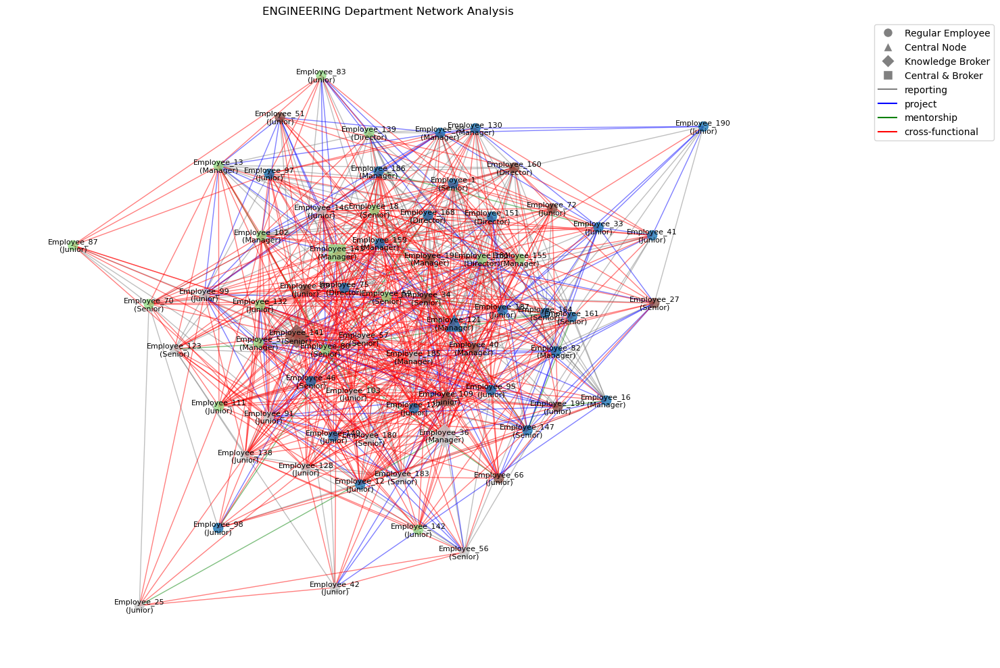


ENGINEERING Department Analysis:

Central Nodes (High Degree Centrality):
Employee_121 - Role: Manager - Years: 20
Employee_109 - Role: Junior - Years: 1
Employee_143 - Role: Manager - Years: 19

Knowledge Brokers (High Betweenness Centrality):
Employee_36 - Role: Manager - Years: 10
Employee_141 - Role: Senior - Years: 20
Employee_143 - Role: Manager - Years: 19

Cluster Analysis:

Cluster 0 - Size: 25
Role Distribution:
  Junior: 10 (40.0%)
  Manager: 7 (28.0%)
  Senior: 5 (20.0%)
  Director: 3 (12.0%)

Cluster 1 - Size: 16
Role Distribution:
  Manager: 5 (31.2%)
  Junior: 5 (31.2%)
  Senior: 4 (25.0%)
  Director: 2 (12.5%)

Cluster 3 - Size: 15
Role Distribution:
  Junior: 8 (53.3%)
  Senior: 5 (33.3%)
  Manager: 2 (13.3%)

Cluster 2 - Size: 12
Role Distribution:
  Junior: 6 (50.0%)
  Senior: 3 (25.0%)
  Manager: 2 (16.7%)
  Director: 1 (8.3%)

Relationship Type Analysis:
Reporting: 181
Project: 98
Mentorship: 12
Cross-functional: 467


In [58]:
import networkx as nx
import matplotlib.pyplot as plt
import random
from community import community_louvain
from matplotlib.lines import Line2D

def generate_employees(num_employees):
    departments = ['GA', 'SALES', 'ENGINEERING']
    roles = ['Junior', 'Senior', 'Manager', 'Director']
    skills = ['Technical', 'Creative', 'Analytical', 'Communication', 'Leadership']
    employees = []
    for i in range(num_employees):
        employee = {
            'id': i,
            'name': f'Employee_{i}',
            'department': random.choice(departments),
            'years_experience': random.randint(1, 20),
            'role': random.choices(roles, weights=[4, 3, 2, 1])[0],  # More juniors, fewer directors
            'skills': random.sample(skills, k=random.randint(1, 3))  # Each employee has 1-3 skills
        }
        employees.append(employee)
    return employees

def create_department_graph(employees, target_department):
    dept_employees = [e for e in employees if e['department'] == target_department]
    G = nx.Graph()
    
    for employee in dept_employees:
        G.add_node(employee['id'], **employee)
    
    # Create hierarchical structure
    roles = {'Director': [], 'Manager': [], 'Senior': [], 'Junior': []}
    for employee in dept_employees:
        roles[employee['role']].append(employee)
    
    # Reporting relationships
    for director in roles['Director']:
        for manager in roles['Manager']:
            G.add_edge(director['id'], manager['id'], relationship='reporting')
    
    for manager in roles['Manager']:
        for senior in random.sample(roles['Senior'], min(len(roles['Senior']), 3)):
            G.add_edge(manager['id'], senior['id'], relationship='reporting')
    
    for senior in roles['Senior']:
        for junior in random.sample(roles['Junior'], min(len(roles['Junior']), 5)):
            G.add_edge(senior['id'], junior['id'], relationship='reporting')
    
    # Project collaborations
    num_projects = len(dept_employees) // 5  # Assume one project for every 5 employees
    for _ in range(num_projects):
        project_team = random.sample(dept_employees, k=random.randint(3, 7))
        for i in range(len(project_team)):
            for j in range(i+1, len(project_team)):
                G.add_edge(project_team[i]['id'], project_team[j]['id'], relationship='project')
    
    # Mentorship program
    mentors = roles['Senior'] + roles['Manager'] + roles['Director']
    mentees = roles['Junior'] + roles['Senior']
    for mentee in mentees:
        if random.random() < 0.4:  # 40% chance of having a mentor
            mentor = random.choice(mentors)
            if mentor['id'] != mentee['id']:
                G.add_edge(mentor['id'], mentee['id'], relationship='mentorship')
    
    # Cross-functional teams (based on skills)
    for skill in ['Technical', 'Creative', 'Analytical', 'Communication', 'Leadership']:
        skilled_employees = [e for e in dept_employees if skill in e['skills']]
        if len(skilled_employees) > 1:
            for i in range(len(skilled_employees)):
                for j in range(i+1, len(skilled_employees)):
                    if random.random() < 0.3:  # 30% chance of connection within skill group
                        G.add_edge(skilled_employees[i]['id'], skilled_employees[j]['id'], relationship='cross-functional')
    
    return G

def analyze_and_visualize_department_network(G, department):
    if len(G) == 0:
        print(f"No employees found in the {department} department.")
        return

    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    
    central_nodes = set(sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:3])
    knowledge_brokers = set(sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:3])
    
    partition = community_louvain.best_partition(G)
    
    num_clusters = len(set(partition.values()))
    color_map = plt.cm.get_cmap('tab20')
    node_colors = [color_map(partition[node] / num_clusters) for node in G.nodes()]
    
    node_sizes = []
    node_shapes = []
    for node in G.nodes():
        size = 300 if node in central_nodes or node in knowledge_brokers else 100
        node_sizes.append(size)
        if node in central_nodes and node in knowledge_brokers:
            node_shapes.append('s')  # square for both
        elif node in central_nodes:
            node_shapes.append('^')  # triangle for central nodes
        elif node in knowledge_brokers:
            node_shapes.append('D')  # diamond for knowledge brokers
        else:
            node_shapes.append('o')  # circle for regular nodes
    
    pos = nx.spring_layout(G, k=0.5, iterations=50)
    plt.figure(figsize=(15, 10))
    
    # Draw nodes
    for shape in set(node_shapes):
        node_list = [node for node, node_shape in zip(G.nodes(), node_shapes) if node_shape == shape]
        nx.draw_networkx_nodes(G, pos, nodelist=node_list, node_color=[node_colors[list(G.nodes()).index(n)] for n in node_list],
                               node_size=[node_sizes[list(G.nodes()).index(n)] for n in node_list], node_shape=shape, alpha=0.8)
    
    # Draw edges with different colors for different relationships
    edge_colors = {'reporting': 'gray', 'project': 'blue', 'mentorship': 'green', 'cross-functional': 'red'}
    for relationship, color in edge_colors.items():
        edges = [(u, v) for (u, v, d) in G.edges(data=True) if d['relationship'] == relationship]
        nx.draw_networkx_edges(G, pos, edgelist=edges, edge_color=color, alpha=0.5)
    
    labels = {node: f"{G.nodes[node]['name']}\n({G.nodes[node]['role']})" for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)
    
    plt.title(f"{department} Department Network Analysis")
    
    # Create legend for nodes and edges
    node_legend = [
        Line2D([0], [0], marker='o', color='w', label='Regular Employee', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='^', color='w', label='Central Node', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='D', color='w', label='Knowledge Broker', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='s', color='w', label='Central & Broker', markerfacecolor='gray', markersize=10)
    ]
    edge_legend = [Line2D([0], [0], color=color, label=relationship) for relationship, color in edge_colors.items()]
    plt.legend(handles=node_legend + edge_legend, loc='upper right', bbox_to_anchor=(1.3, 1))
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    print(f"\n{department} Department Analysis:")
    print("\nCentral Nodes (High Degree Centrality):")
    for node in central_nodes:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']}")
    
    print("\nKnowledge Brokers (High Betweenness Centrality):")
    for node in knowledge_brokers:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']}")
    
    print("\nCluster Analysis:")
    cluster_sizes = {}
    cluster_roles = {}
    for node, cluster in partition.items():
        cluster_sizes[cluster] = cluster_sizes.get(cluster, 0) + 1
        role = G.nodes[node]['role']
        if cluster not in cluster_roles:
            cluster_roles[cluster] = {}
        cluster_roles[cluster][role] = cluster_roles[cluster].get(role, 0) + 1
    
    for cluster, size in sorted(cluster_sizes.items(), key=lambda x: x[1], reverse=True):
        print(f"\nCluster {cluster} - Size: {size}")
        print("Role Distribution:")
        for role, count in sorted(cluster_roles[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {role}: {count} ({count/size*100:.1f}%)")

    # Relationship type analysis
    relationship_counts = {rel: 0 for rel in edge_colors.keys()}
    for _, _, data in G.edges(data=True):
        relationship_counts[data['relationship']] += 1
    
    print("\nRelationship Type Analysis:")
    for rel, count in relationship_counts.items():
        print(f"{rel.capitalize()}: {count}")
def analyze_and_visualize_cross_functional_network(G, department):
    if len(G) == 0:
        print(f"No employees found in the {department} department.")
        return

    # Create a subgraph with only cross-functional edges
    cross_functional_edges = [(u, v) for (u, v, d) in G.edges(data=True) if d['relationship'] == 'cross-functional']
    G_cross = G.edge_subgraph(cross_functional_edges)

    if len(G_cross) == 0:
        print(f"No cross-functional relationships found in the {department} department.")
        return

    degree_centrality = nx.degree_centrality(G_cross)
    betweenness_centrality = nx.betweenness_centrality(G_cross)
    
    central_nodes = set(sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:3])
    knowledge_brokers = set(sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:3])
    
    partition = community_louvain.best_partition(G_cross)
    
    num_clusters = len(set(partition.values()))
    color_map = plt.cm.get_cmap('tab20')
    node_colors = [color_map(partition[node] / num_clusters) for node in G_cross.nodes()]
    
    node_sizes = []
    node_shapes = []
    for node in G_cross.nodes():
        size = 300 if node in central_nodes or node in knowledge_brokers else 100
        node_sizes.append(size)
        if node in central_nodes and node in knowledge_brokers:
            node_shapes.append('s')  # square for both
        elif node in central_nodes:
            node_shapes.append('^')  # triangle for central nodes
        elif node in knowledge_brokers:
            node_shapes.append('D')  # diamond for knowledge brokers
        else:
            node_shapes.append('o')  # circle for regular nodes
    
    pos = nx.spring_layout(G_cross, k=0.5, iterations=50)
    plt.figure(figsize=(15, 10))
    
    # Draw nodes
    for shape in set(node_shapes):
        node_list = [node for node, node_shape in zip(G_cross.nodes(), node_shapes) if node_shape == shape]
        nx.draw_networkx_nodes(G_cross, pos, nodelist=node_list, node_color=[node_colors[list(G_cross.nodes()).index(n)] for n in node_list],
                               node_size=[node_sizes[list(G_cross.nodes()).index(n)] for n in node_list], node_shape=shape, alpha=0.8)
    
    # Draw edges
    nx.draw_networkx_edges(G_cross, pos, edge_color='red', alpha=0.5)
    
    labels = {node: f"{G.nodes[node]['name']}\n({G.nodes[node]['role']})" for node in G_cross.nodes()}
    nx.draw_networkx_labels(G_cross, pos, labels, font_size=8)
    
    plt.title(f"{department} Department Cross-Functional Network Analysis")
    
    # Create legend for nodes
    node_legend = [
        Line2D([0], [0], marker='o', color='w', label='Regular Employee', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='^', color='w', label='Central Node', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='D', color='w', label='Knowledge Broker', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='s', color='w', label='Central & Broker', markerfacecolor='gray', markersize=10)
    ]
    plt.legend(handles=node_legend, loc='upper right', bbox_to_anchor=(1.3, 1))
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    print(f"\n{department} Department Cross-Functional Network Analysis:")
    print("\nCentral Nodes (High Degree Centrality):")
    for node in central_nodes:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']} - Skills: {', '.join(G.nodes[node]['skills'])}")
    
    print("\nKnowledge Brokers (High Betweenness Centrality):")
    for node in knowledge_brokers:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']} - Skills: {', '.join(G.nodes[node]['skills'])}")
    
    print("\nCluster Analysis:")
    cluster_sizes = {}
    cluster_roles = {}
    cluster_skills = {}
    for node, cluster in partition.items():
        cluster_sizes[cluster] = cluster_sizes.get(cluster, 0) + 1
        role = G.nodes[node]['role']
        skills = G.nodes[node]['skills']
        if cluster not in cluster_roles:
            cluster_roles[cluster] = {}
            cluster_skills[cluster] = {}
        cluster_roles[cluster][role] = cluster_roles[cluster].get(role, 0) + 1
        for skill in skills:
            cluster_skills[cluster][skill] = cluster_skills[cluster].get(skill, 0) + 1
    
    for cluster, size in sorted(cluster_sizes.items(), key=lambda x: x[1], reverse=True):
        print(f"\nCluster {cluster} - Size: {size}")
        print("Role Distribution:")
        for role, count in sorted(cluster_roles[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {role}: {count} ({count/size*100:.1f}%)")
        print("Skill Distribution:")
        for skill, count in sorted(cluster_skills[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {skill}: {count} ({count/size*100:.1f}%)")

    print("\nNetwork Statistics:")
    print(f"Number of nodes: {G_cross.number_of_nodes()}")
    print(f"Number of edges: {G_cross.number_of_edges()}")
    print(f"Average clustering coefficient: {nx.average_clustering(G_cross):.3f}")
    print(f"Network density: {nx.density(G_cross):.3f}")

# Main execution
num_employees = 200
employees = generate_employees(num_employees)

# Select a department for analysis
target_department = 'ENGINEERING'  # You can change this to any department

G = create_department_graph(employees, target_department)
analyze_and_visualize_cross_functional_network(G, target_department)
# Main execution
#num_employees = 200
#employees = generate_employees(num_employees)

# Select a department for analysis
#target_department = 'ENGINEERING'  # You can change this to any department

#G = create_department_graph(employees, target_department)
analyze_and_visualize_department_network(G, target_department)

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\592777836.py:53: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



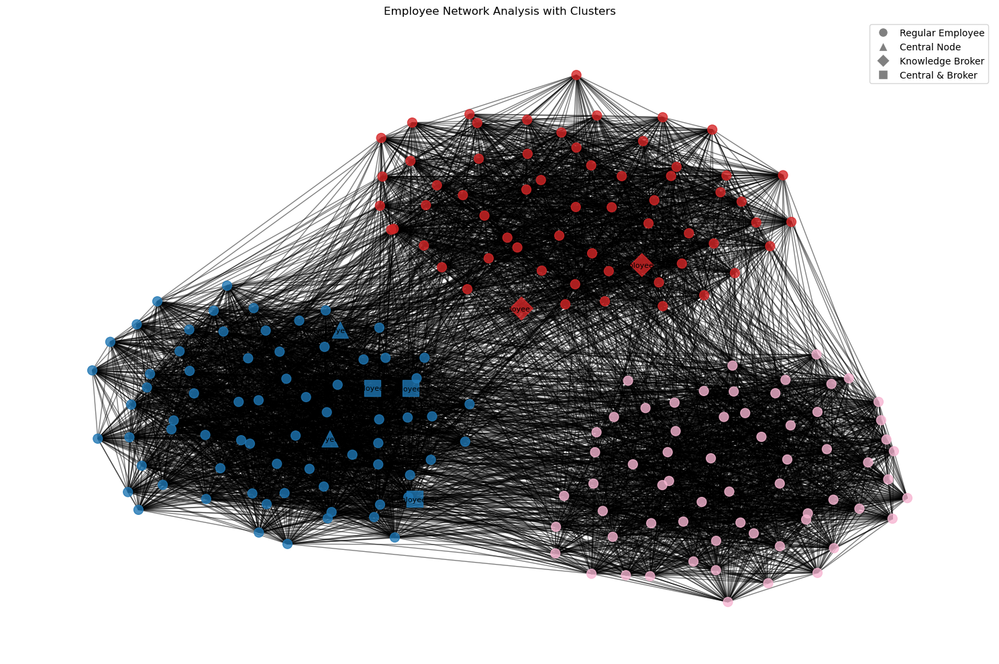

Central Nodes (High Degree Centrality):
Employee_32 - Department: GA - Cluster: 0
Employee_194 - Department: GA - Cluster: 0
Employee_78 - Department: GA - Cluster: 0
Employee_176 - Department: GA - Cluster: 0
Employee_55 - Department: GA - Cluster: 0

Knowledge Brokers (High Betweenness Centrality):
Employee_32 - Department: GA - Cluster: 0
Employee_141 - Department: ENGINEERING - Cluster: 1
Employee_78 - Department: GA - Cluster: 0
Employee_55 - Department: GA - Cluster: 0
Employee_31 - Department: ENGINEERING - Cluster: 1

Cluster Analysis:

Cluster 0 - Size: 75
Department Distribution:
  GA: 75 (100.0%)

Cluster 2 - Size: 63
Department Distribution:
  SALES: 63 (100.0%)

Cluster 1 - Size: 62
Department Distribution:
  ENGINEERING: 62 (100.0%)


In [57]:
G = create_employee_graph(employees)
analyze_and_visualize_network(G)

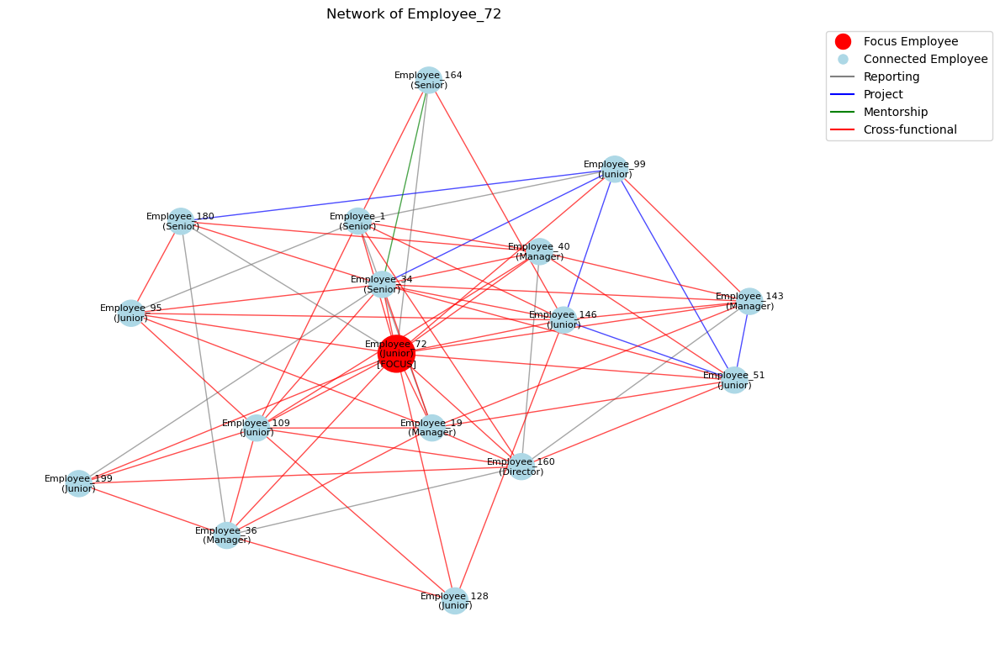


Focus Employee: Employee_72
Role: Junior
Department: ENGINEERING
Years of Experience: 15
Skills: Communication, Analytical

Number of direct connections: 16

Types of connections:
  Reporting: 10
  Project: 6
  Mentorship: 1
  Cross-functional: 52

Roles of connections:
  Junior: 7
  Senior: 4
  Manager: 4
  Director: 1


In [59]:
def plot_single_employee_network(G, employee_id):
    if employee_id not in G.nodes():
        print(f"Employee with ID {employee_id} not found in the graph.")
        return

    # Get the ego network (employee + immediate connections)
    ego_network = nx.ego_graph(G, employee_id, radius=1)
    
    # Add connections between the immediate neighbors
    for neighbor in ego_network.neighbors(employee_id):
        for second_neighbor in ego_network.neighbors(employee_id):
            if neighbor != second_neighbor and G.has_edge(neighbor, second_neighbor):
                ego_network.add_edge(neighbor, second_neighbor, 
                                     relationship=G[neighbor][second_neighbor]['relationship'])

    pos = nx.spring_layout(ego_network, k=0.5, iterations=50)
    plt.figure(figsize=(12, 8))

    # Prepare node colors and sizes
    node_colors = []
    node_sizes = []
    for node in ego_network.nodes():
        if node == employee_id:
            node_colors.append('red')
            node_sizes.append(1000)
        else:
            node_colors.append('lightblue')
            node_sizes.append(500)

    # Draw nodes
    nx.draw_networkx_nodes(ego_network, pos, node_color=node_colors, node_size=node_sizes)

    # Draw edges with different colors for different relationships
    edge_colors = {'reporting': 'gray', 'project': 'blue', 'mentorship': 'green', 'cross-functional': 'red'}
    for relationship, color in edge_colors.items():
        edges = [(u, v) for (u, v, d) in ego_network.edges(data=True) if d['relationship'] == relationship]
        nx.draw_networkx_edges(ego_network, pos, edgelist=edges, edge_color=color, alpha=0.7)

    # Prepare labels
    labels = {}
    for node in ego_network.nodes():
        if node == employee_id:
            labels[node] = f"{G.nodes[node]['name']}\n({G.nodes[node]['role']})\n[FOCUS]"
        else:
            labels[node] = f"{G.nodes[node]['name']}\n({G.nodes[node]['role']})"
    
    nx.draw_networkx_labels(ego_network, pos, labels, font_size=8)

    # Create legend
    legend_elements = [Line2D([0], [0], marker='o', color='w', label='Focus Employee',
                              markerfacecolor='red', markersize=15),
                       Line2D([0], [0], marker='o', color='w', label='Connected Employee',
                              markerfacecolor='lightblue', markersize=10)]
    for relationship, color in edge_colors.items():
        legend_elements.append(Line2D([0], [0], color=color, label=relationship.capitalize()))

    plt.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(1, 1))

    employee_name = G.nodes[employee_id]['name']
    plt.title(f"Network of {employee_name}")
    plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Print additional information about the focus employee
    print(f"\nFocus Employee: {employee_name}")
    print(f"Role: {G.nodes[employee_id]['role']}")
    print(f"Department: {G.nodes[employee_id]['department']}")
    print(f"Years of Experience: {G.nodes[employee_id]['years_experience']}")
    print(f"Skills: {', '.join(G.nodes[employee_id]['skills'])}")

    # Analyze connections
    connections = list(ego_network.neighbors(employee_id))
    print(f"\nNumber of direct connections: {len(connections)}")
    
    relationship_counts = {rel: 0 for rel in edge_colors.keys()}
    for _, _, data in ego_network.edges(data=True):
        if data['relationship'] in relationship_counts:
            relationship_counts[data['relationship']] += 1

    print("\nTypes of connections:")
    for rel, count in relationship_counts.items():
        print(f"  {rel.capitalize()}: {count}")

    # Analyze roles of connections
    connection_roles = {}
    for neighbor in connections:
        role = G.nodes[neighbor]['role']
        connection_roles[role] = connection_roles.get(role, 0) + 1

    print("\nRoles of connections:")
    for role, count in connection_roles.items():
        print(f"  {role}: {count}")

# # Main execution
# num_employees = 200
# employees = generate_employees(num_employees)

# # Select a department for analysis
# target_department = 'ENGINEERING'  # You can change this to any department

# G = create_department_graph(employees, target_department)

# Randomly select an employee from the department for individual analysis
department_employees = [e['id'] for e in employees if e['department'] == target_department]
if department_employees:
    random_employee_id = random.choice(department_employees)
    plot_single_employee_network(G, random_employee_id)
else:
    print(f"No employees found in the {target_department} department.")

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\4027413136.py:109: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



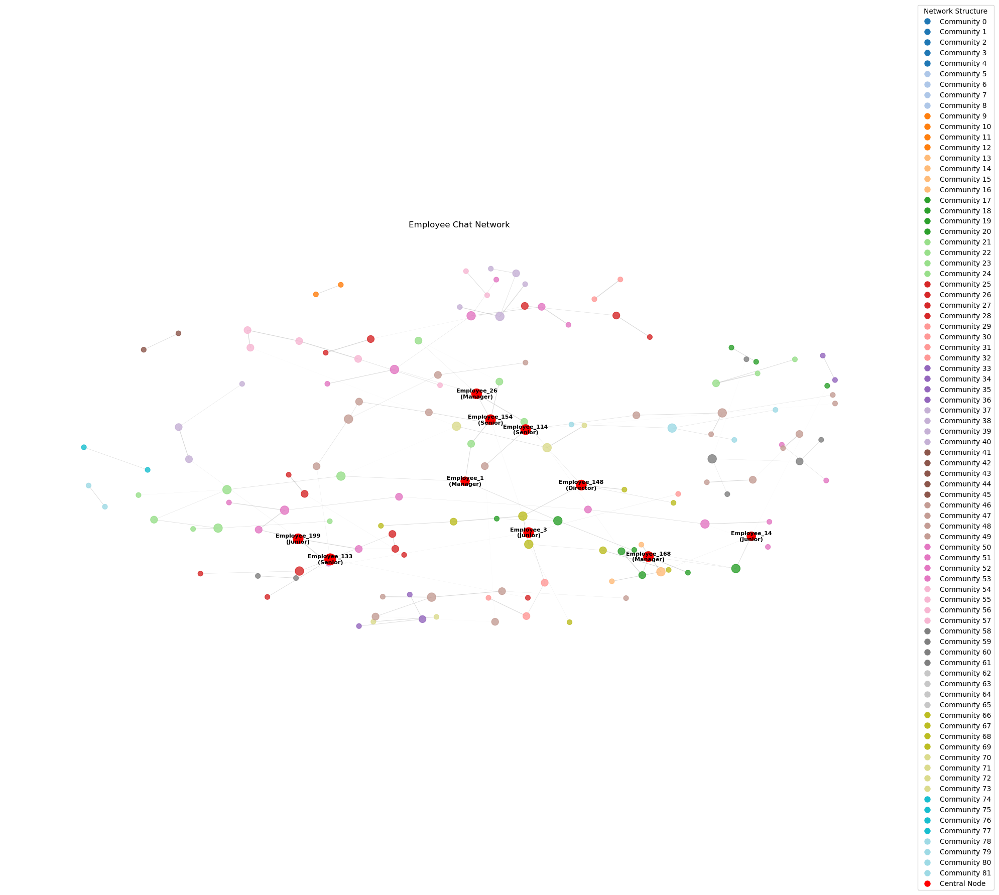


Chat Network Analysis:
Number of employees: 200
Number of chat connections: 132

Average number of chat connections per employee: 1.32

Top 5 most central employees (by number of chat connections):
  Employee_133 (Senior, ENGINEERING): 0.025
  Employee_3 (Junior, GA): 0.020
  Employee_26 (Manager, GA): 0.020
  Employee_114 (Senior, GA): 0.020
  Employee_148 (Director, SALES): 0.020

Top 5 most active chat connections:
  Employee_35 <-> Employee_145: 20 messages
  Employee_46 <-> Employee_199: 20 messages
  Employee_73 <-> Employee_171: 20 messages
  Employee_20 <-> Employee_176: 19 messages
  Employee_25 <-> Employee_192: 19 messages

Top interdepartmental interactions:
  ENGINEERING <-> SALES: 369 messages
  ENGINEERING <-> GA: 299 messages
  GA <-> SALES: 269 messages

Number of potential silos identified: 0


In [64]:
import networkx as nx
import matplotlib.pyplot as plt
import random
from collections import defaultdict
import datetime

def generate_employees(num_employees):
    departments = ['GA', 'SALES', 'ENGINEERING']
    roles = ['Junior', 'Senior', 'Manager', 'Director']
    skills = ['Technical', 'Creative', 'Analytical', 'Communication', 'Leadership']
    employees = []
    for i in range(num_employees):
        employee = {
            'id': i,
            'name': f'Employee_{i}',
            'department': random.choice(departments),
            'years_experience': random.randint(1, 20),
            'role': random.choices(roles, weights=[4, 3, 2, 1])[0],  # More juniors, fewer directors
            'skills': random.sample(skills, k=random.randint(1, 3))  # Each employee has 1-3 skills
        }
        employees.append(employee)
    return employees

def generate_chat_interactions(employees, num_days=30, avg_chats_per_day=5):
    interactions = []
    start_date = datetime.date.today() - datetime.timedelta(days=num_days)
    
    for day in range(num_days):
        current_date = start_date + datetime.timedelta(days=day)
        num_chats = random.randint(avg_chats_per_day - 2, avg_chats_per_day + 2)
        
        for _ in range(num_chats):
            sender = random.choice(employees)
            receiver = random.choice(employees)
            while receiver == sender:
                receiver = random.choice(employees)
            
            interaction = {
                'date': current_date,
                'sender_id': sender['id'],
                'receiver_id': receiver['id'],
                'message_count': random.randint(1, 20)  # Number of messages in this chat
            }
            interactions.append(interaction)
    
    return interactions

def create_chat_network(employees, interactions):
    G = nx.Graph()
    
    # Add nodes
    for employee in employees:
        G.add_node(employee['id'], **employee)
    
    # Add edges based on chat interactions
    edge_weights = defaultdict(int)
    for interaction in interactions:
        sender = interaction['sender_id']
        receiver = interaction['receiver_id']
        weight = interaction['message_count']
        edge_weights[(sender, receiver)] += weight
    
    for (sender, receiver), weight in edge_weights.items():
        G.add_edge(sender, receiver, weight=weight)
    
    return G

def identify_silos(G, threshold=0.7):
    # Use the Louvain method for community detection
    partition = community_louvain.best_partition(G)
    
    # Count the nodes in each community
    community_sizes = defaultdict(int)
    for node, community_id in partition.items():
        community_sizes[community_id] += 1
    
    # Identify potential silos (communities with low external connectivity)
    silos = []
    for community_id in set(partition.values()):
        nodes_in_community = [node for node, com in partition.items() if com == community_id]
        subgraph = G.subgraph(nodes_in_community)
        internal_edges = subgraph.number_of_edges()
        total_edges = sum(G.degree(node) for node in nodes_in_community)
        if internal_edges / (total_edges+1) > threshold:
            silos.append(nodes_in_community)
    
    return silos, partition

def plot_chat_network(G, title="Employee Chat Network"):
    plt.figure(figsize=(20, 15))
    
    # Calculate node sizes based on degree centrality
    degree_centrality = nx.degree_centrality(G)
    node_sizes = [v * 10000 for v in degree_centrality.values()]
    
    # Identify central nodes (top 5% by degree centrality)
    central_nodes = sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:int(len(G.nodes) * 0.05)]
    
    # Identify silos and get community partition
    silos, partition = identify_silos(G)
    
    # Calculate edge weights
    edge_weights = [G[u][v]['weight'] for u, v in G.edges()]
    max_weight = max(edge_weights)
    normalized_weights = [w / max_weight for w in edge_weights]
    
    # Set up colors for communities
    num_communities = len(set(partition.values()))
    color_map = plt.cm.get_cmap('tab20')
    color_dict = {com: color_map(i/num_communities) for i, com in enumerate(set(partition.values()))}
    node_colors = [color_dict[partition[node]] for node in G.nodes()]
    
    # Position nodes using force-directed layout
    pos = nx.spring_layout(G, k=0.5, iterations=50)
    
    # Draw edges
    nx.draw_networkx_edges(G, pos, width=normalized_weights, alpha=0.3, edge_color='gray')
    
    # Draw nodes
    nx.draw_networkx_nodes(G, pos, node_color=node_colors, node_size=node_sizes, alpha=0.8)
    
    # Highlight central nodes
    nx.draw_networkx_nodes(G, pos, nodelist=central_nodes, node_color='red', node_size=[node_sizes[list(G.nodes()).index(node)] for node in central_nodes], alpha=1.0)
    
    # Add labels for central nodes
    central_labels = {node: f"{G.nodes[node]['name']}\n({G.nodes[node]['role']})" for node in central_nodes}
    nx.draw_networkx_labels(G, pos, central_labels, font_size=8, font_weight='bold')
    
    # Highlight silos
    for i, silo in enumerate(silos):
        nx.draw_networkx_nodes(G, pos, nodelist=silo, node_color='none', node_size=[node_sizes[list(G.nodes()).index(node)] for node in silo],
                               alpha=1.0, linewidths=2, edgecolors=f'C{i}')
    
    # Create legend for departments and silos
    legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label=f'Community {i}',
                                  markerfacecolor=color, markersize=10)
                       for i, color in color_dict.items()]
    legend_elements.append(plt.Line2D([0], [0], marker='o', color='w', label='Central Node',
                                      markerfacecolor='red', markersize=10))
    for i in range(len(silos)):
        legend_elements.append(plt.Line2D([0], [0], marker='o', color='w', label=f'Silo {i+1}',
                                          markerfacecolor='none', markeredgecolor=f'C{i}', markersize=10))
    
    plt.legend(handles=legend_elements, title="Network Structure", loc='center left', bbox_to_anchor=(1, 0.5))
    
    plt.title(title)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

def analyze_chat_network(G):
    print("\nChat Network Analysis:")
    print(f"Number of employees: {G.number_of_nodes()}")
    print(f"Number of chat connections: {G.number_of_edges()}")
    
    # Degree analysis
    degrees = [d for n, d in G.degree()]
    avg_degree = sum(degrees) / len(degrees)
    print(f"\nAverage number of chat connections per employee: {avg_degree:.2f}")
    
    # Most central employees (by degree centrality)
    degree_centrality = nx.degree_centrality(G)
    top_central = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
    print("\nTop 5 most central employees (by number of chat connections):")
    for node_id, centrality in top_central:
        employee = G.nodes[node_id]
        print(f"  {employee['name']} ({employee['role']}, {employee['department']}): {centrality:.3f}")
    
    # Most active chat connections
    top_edges = sorted(G.edges(data=True), key=lambda x: x[2]['weight'], reverse=True)[:5]
    print("\nTop 5 most active chat connections:")
    for u, v, data in top_edges:
        employee1 = G.nodes[u]
        employee2 = G.nodes[v]
        print(f"  {employee1['name']} <-> {employee2['name']}: {data['weight']} messages")
    
    # Department interaction analysis
    dept_interactions = defaultdict(int)
    for u, v, data in G.edges(data=True):
        dept1 = G.nodes[u]['department']
        dept2 = G.nodes[v]['department']
        if dept1 != dept2:
            dept_interactions[tuple(sorted((dept1, dept2)))] += data['weight']
    
    print("\nTop interdepartmental interactions:")
    top_dept_interactions = sorted(dept_interactions.items(), key=lambda x: x[1], reverse=True)[:5]
    for (dept1, dept2), weight in top_dept_interactions:
        print(f"  {dept1} <-> {dept2}: {weight} messages")
    
    # Silo analysis
    silos, _ = identify_silos(G)
    print(f"\nNumber of potential silos identified: {len(silos)}")
    for i, silo in enumerate(silos, 1):
        print(f"  Silo {i}: {len(silo)} employees")
        departments = defaultdict(int)
        for node in silo:
            departments[G.nodes[node]['department']] += 1
        print("    Department distribution:")
        for dept, count in departments.items():
            print(f"      {dept}: {count} employees")

# Main execution
num_employees = 200
employees = generate_employees(num_employees)
chat_interactions = generate_chat_interactions(employees, num_days=30, avg_chats_per_day=5)

G_chat = create_chat_network(employees, chat_interactions)
plot_chat_network(G_chat)
analyze_chat_network(G_chat)

In [67]:
import networkx as nx
import matplotlib.pyplot as plt
import random
from collections import defaultdict
import datetime

def generate_employees(num_employees):
    departments = ['GA', 'SALES', 'ENGINEERING', 'MARKETING', 'HR']
    roles = ['Junior', 'Senior', 'Manager', 'Director']
    skills = ['Technical', 'Creative', 'Analytical', 'Communication', 'Leadership']
    employees = []
    for i in range(num_employees):
        employee = {
            'id': f'E{i}',
            'name': f'Employee_{i}',
            'department': random.choice(departments),
            'years_experience': random.randint(1, 20),
            'role': random.choices(roles, weights=[4, 3, 2, 1])[0],  # More juniors, fewer directors
            'skills': random.sample(skills, k=random.randint(1, 3))  # Each employee has 1-3 skills
        }
        employees.append(employee)
    return employees

def generate_chat_interactions(employees, num_days=30, avg_chats_per_day=5):
    interactions = []
    start_date = datetime.date.today() - datetime.timedelta(days=num_days)
    
    for day in range(num_days):
        current_date = start_date + datetime.timedelta(days=day)
        num_chats = random.randint(avg_chats_per_day - 2, avg_chats_per_day + 2)
        
        for _ in range(num_chats):
            sender = random.choice(employees)
            receiver = random.choice(employees)
            while receiver == sender:
                receiver = random.choice(employees)
            
            interaction = {
                'date': current_date,
                'sender_id': sender['id'],
                'receiver_id': receiver['id'],
                'message_count': random.randint(1, 20)  # Number of messages in this chat
            }
            interactions.append(interaction)
    
    return interactions

def generate_workflows(num_workflows):
    workflow_types = ['Approval', 'Review', 'Development', 'Testing', 'Deployment']
    workflows = []
    for i in range(num_workflows):
        workflow = {
            'id': f'W{i}',
            'name': f'{random.choice(workflow_types)} Workflow {i}',
            'steps': random.randint(3, 7)
        }
        workflows.append(workflow)
    return workflows

def generate_processes(num_processes):
    process_types = ['Onboarding', 'Project Management', 'Customer Support', 'Quality Assurance', 'Financial Reporting']
    processes = []
    for i in range(num_processes):
        process = {
            'id': f'P{i}',
            'name': f'{random.choice(process_types)} Process {i}',
            'steps': random.randint(4, 8)
        }
        processes.append(process)
    return processes

def assign_workflows_and_processes(employees, workflows, processes):
    assignments = []
    for workflow in workflows:
        assigned_employees = random.sample(employees, k=workflow['steps'])
        for step, employee in enumerate(assigned_employees):
            assignments.append({
                'employee_id': employee['id'],
                'workflow_id': workflow['id'],
                'step': step + 1
            })
    
    for process in processes:
        assigned_employees = random.sample(employees, k=process['steps'])
        for step, employee in enumerate(assigned_employees):
            assignments.append({
                'employee_id': employee['id'],
                'process_id': process['id'],
                'step': step + 1
            })
    
    return assignments

def create_organization_network(employees, chat_interactions, workflows, processes, assignments):
    G = nx.Graph()
    
    # Add employee nodes
    for employee in employees:
        G.add_node(employee['id'], **employee, node_type='employee')
    
    # Add workflow and process nodes
    for workflow in workflows:
        G.add_node(workflow['id'], **workflow, node_type='workflow')
    for process in processes:
        G.add_node(process['id'], **process, node_type='process')
    
    # Add edges based on chat interactions
    edge_weights = defaultdict(int)
    for interaction in chat_interactions:
        sender = interaction['sender_id']
        receiver = interaction['receiver_id']
        weight = interaction['message_count']
        edge_weights[(sender, receiver)] += weight
    
    for (sender, receiver), weight in edge_weights.items():
        G.add_edge(sender, receiver, weight=weight, edge_type='chat')
    
    # Add edges based on workflow and process assignments
    for assignment in assignments:
        if 'workflow_id' in assignment:
            G.add_edge(assignment['employee_id'], assignment['workflow_id'], 
                       step=assignment['step'], edge_type='workflow')
        elif 'process_id' in assignment:
            G.add_edge(assignment['employee_id'], assignment['process_id'], 
                       step=assignment['step'], edge_type='process')
    
    return G

def plot_organization_network(G, title="Organization Network"):
    plt.figure(figsize=(20, 15))
    
    # Separate nodes by type
    employee_nodes = [node for node, data in G.nodes(data=True) if data['node_type'] == 'employee']
    workflow_nodes = [node for node, data in G.nodes(data=True) if data['node_type'] == 'workflow']
    process_nodes = [node for node, data in G.nodes(data=True) if data['node_type'] == 'process']
    
    # Calculate node sizes
    employee_sizes = [G.degree(node) * 50 for node in employee_nodes]
    workflow_sizes = [data['steps'] * 100 for node, data in G.nodes(data=True) if data['node_type'] == 'workflow']
    process_sizes = [data['steps'] * 100 for node, data in G.nodes(data=True) if data['node_type'] == 'process']
    
    # Set up colors
    employee_colors = [plt.cm.Set3(G.nodes[node]['department']) for node in employee_nodes]
    workflow_color = 'lightgreen'
    process_color = 'lightsalmon'
    
    # Position nodes using force-directed layout
    pos = nx.spring_layout(G, k=0.5, iterations=50)
    
    # Draw nodes
    nx.draw_networkx_nodes(G, pos, nodelist=employee_nodes, node_color=employee_colors, node_size=employee_sizes, alpha=0.8)
    nx.draw_networkx_nodes(G, pos, nodelist=workflow_nodes, node_color=workflow_color, node_size=workflow_sizes, alpha=0.8, node_shape='s')
    nx.draw_networkx_nodes(G, pos, nodelist=process_nodes, node_color=process_color, node_size=process_sizes, alpha=0.8, node_shape='d')
    
    # Draw edges
    chat_edges = [(u, v) for (u, v, d) in G.edges(data=True) if d['edge_type'] == 'chat']
    workflow_edges = [(u, v) for (u, v, d) in G.edges(data=True) if d['edge_type'] == 'workflow']
    process_edges = [(u, v) for (u, v, d) in G.edges(data=True) if d['edge_type'] == 'process']
    
    nx.draw_networkx_edges(G, pos, edgelist=chat_edges, edge_color='gray', alpha=0.3)
    nx.draw_networkx_edges(G, pos, edgelist=workflow_edges, edge_color='green', alpha=0.5)
    nx.draw_networkx_edges(G, pos, edgelist=process_edges, edge_color='red', alpha=0.5)
    
    # Add labels
    labels = {node: G.nodes[node]['name'] for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)
    
    # Create legend
    employee_legend = plt.Line2D([0], [0], marker='o', color='w', label='Employee', markerfacecolor='lightblue', markersize=10)
    workflow_legend = plt.Line2D([0], [0], marker='s', color='w', label='Workflow', markerfacecolor=workflow_color, markersize=10)
    process_legend = plt.Line2D([0], [0], marker='d', color='w', label='Process', markerfacecolor=process_color, markersize=10)
    chat_edge = plt.Line2D([0], [0], color='gray', label='Chat')
    workflow_edge = plt.Line2D([0], [0], color='green', label='Workflow Assignment')
    process_edge = plt.Line2D([0], [0], color='red', label='Process Assignment')
    
    plt.legend(handles=[employee_legend, workflow_legend, process_legend, chat_edge, workflow_edge, process_edge],
               loc='upper left', bbox_to_anchor=(1, 1))
    
    plt.title(title)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

def analyze_organization_network(G):
    print("\nOrganization Network Analysis:")
    print(f"Number of employees: {len([n for n, d in G.nodes(data=True) if d['node_type'] == 'employee'])}")
    print(f"Number of workflows: {len([n for n, d in G.nodes(data=True) if d['node_type'] == 'workflow'])}")
    print(f"Number of processes: {len([n for n, d in G.nodes(data=True) if d['node_type'] == 'process'])}")
    
    # Most central employees (by degree centrality)
    employee_nodes = [node for node, data in G.nodes(data=True) if data['node_type'] == 'employee']
    employee_subgraph = G.subgraph(employee_nodes)
    degree_centrality = nx.degree_centrality(employee_subgraph)
    top_central = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
    print("\nTop 5 most central employees:")
    for node_id, centrality in top_central:
        employee = G.nodes[node_id]
        print(f"  {employee['name']} ({employee['role']}, {employee['department']}): {centrality:.3f}")
    
    # Most complex workflows and processes
    workflows = sorted([(n, d['steps']) for n, d in G.nodes(data=True) if d['node_type'] == 'workflow'], key=lambda x: x[1], reverse=True)[:3]
    processes = sorted([(n, d['steps']) for n, d in G.nodes(data=True) if d['node_type'] == 'process'], key=lambda x: x[1], reverse=True)[:3]
    
    print("\nMost complex workflows:")
    for workflow_id, steps in workflows:
        print(f"  {G.nodes[workflow_id]['name']}: {steps} steps")
    
    print("\nMost complex processes:")
    for process_id, steps in processes:
        print(f"  {G.nodes[process_id]['name']}: {steps} steps")
    
    # Employees involved in most workflows/processes
    involvement = defaultdict(int)
    for u, v, data in G.edges(data=True):
        if data['edge_type'] in ['workflow', 'process']:
            involvement[u] += 1
    
    top_involved = sorted(involvement.items(), key=lambda x: x[1], reverse=True)[:5]
    print("\nEmployees involved in most workflows/processes:")
    for employee_id, count in top_involved:
        employee = G.nodes[employee_id]
        print(f"  {employee['name']} ({employee['role']}, {employee['department']}): {count}")

# Main execution
num_employees = 50
num_workflows = 10
num_processes = 8

employees = generate_employees(num_employees)
chat_interactions = generate_chat_interactions(employees, num_days=30, avg_chats_per_day=5)
workflows = generate_workflows(num_workflows)
processes = generate_processes(num_processes)
assignments = assign_workflows_and_processes(employees, workflows, processes)

G_org = create_organization_network(employees, chat_interactions, workflows, processes, assignments)
plot_organization_network(G_org)
analyze_organization_network(G_org)

TypeError: '<' not supported between instances of 'numpy.ndarray' and 'int'

<Figure size 2000x1500 with 0 Axes>

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\3330452280.py:148: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



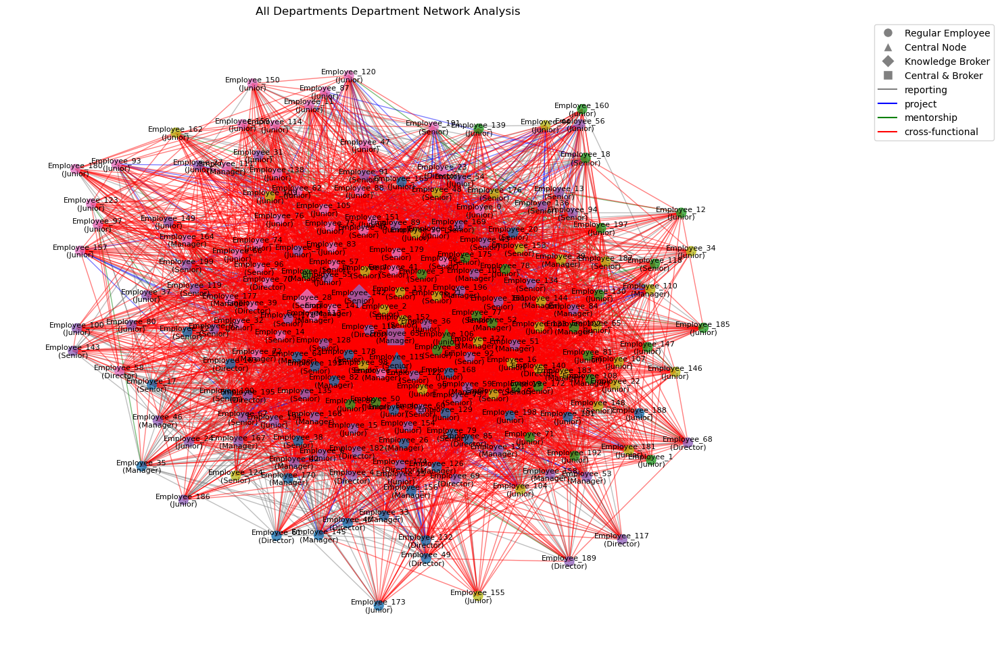


All Departments Department Analysis:

Central Nodes (High Degree Centrality):
Employee_106 - Role: Junior - Years: 20
Employee_115 - Role: Senior - Years: 19
Employee_63 - Role: Manager - Years: 8

Knowledge Brokers (High Betweenness Centrality):
Employee_28 - Role: Senior - Years: 11
Employee_142 - Role: Senior - Years: 12
Employee_63 - Role: Manager - Years: 8

Cluster Analysis:

Cluster 2 - Size: 62
Role Distribution:
  Senior: 21 (33.9%)
  Junior: 19 (30.6%)
  Manager: 13 (21.0%)
  Director: 9 (14.5%)

Cluster 3 - Size: 45
Role Distribution:
  Junior: 25 (55.6%)
  Senior: 9 (20.0%)
  Manager: 7 (15.6%)
  Director: 4 (8.9%)

Cluster 4 - Size: 34
Role Distribution:
  Junior: 15 (44.1%)
  Senior: 13 (38.2%)
  Manager: 5 (14.7%)
  Director: 1 (2.9%)

Cluster 0 - Size: 32
Role Distribution:
  Senior: 9 (28.1%)
  Manager: 9 (28.1%)
  Junior: 8 (25.0%)
  Director: 6 (18.8%)

Cluster 1 - Size: 27
Role Distribution:
  Junior: 15 (55.6%)
  Senior: 8 (29.6%)
  Manager: 4 (14.8%)

Relationshi

C:\Users\raghu\AppData\Local\Temp\ipykernel_229208\3330452280.py:254: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



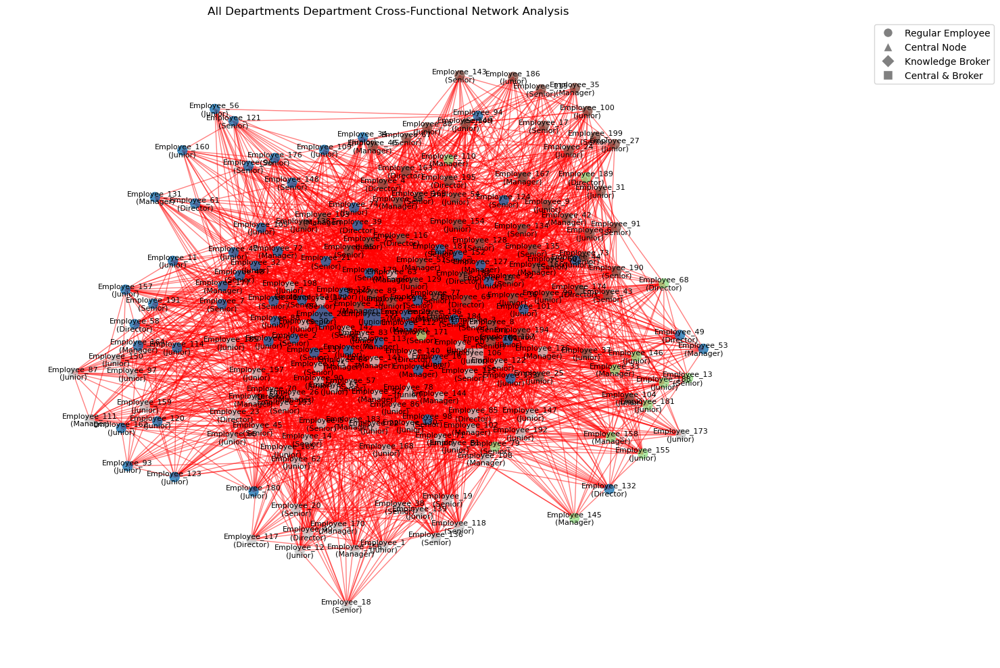


All Departments Department Cross-Functional Network Analysis:

Central Nodes (High Degree Centrality):
Employee_106 - Role: Junior - Years: 20 - Skills: Technical, Analytical, Creative
Employee_78 - Role: Junior - Years: 7 - Skills: Analytical, Technical, Leadership
Employee_151 - Role: Junior - Years: 16 - Skills: Creative, Leadership, Analytical

Knowledge Brokers (High Betweenness Centrality):
Employee_106 - Role: Junior - Years: 20 - Skills: Technical, Analytical, Creative
Employee_28 - Role: Senior - Years: 11 - Skills: Communication, Analytical, Leadership
Employee_151 - Role: Junior - Years: 16 - Skills: Creative, Leadership, Analytical

Cluster Analysis:

Cluster 3 - Size: 66
Role Distribution:
  Junior: 29 (43.9%)
  Senior: 17 (25.8%)
  Manager: 14 (21.2%)
  Director: 6 (9.1%)
Skill Distribution:
  Technical: 60 (90.9%)
  Leadership: 27 (40.9%)
  Analytical: 20 (30.3%)
  Communication: 14 (21.2%)
  Creative: 11 (16.7%)

Cluster 0 - Size: 63
Role Distribution:
  Junior: 27 (42

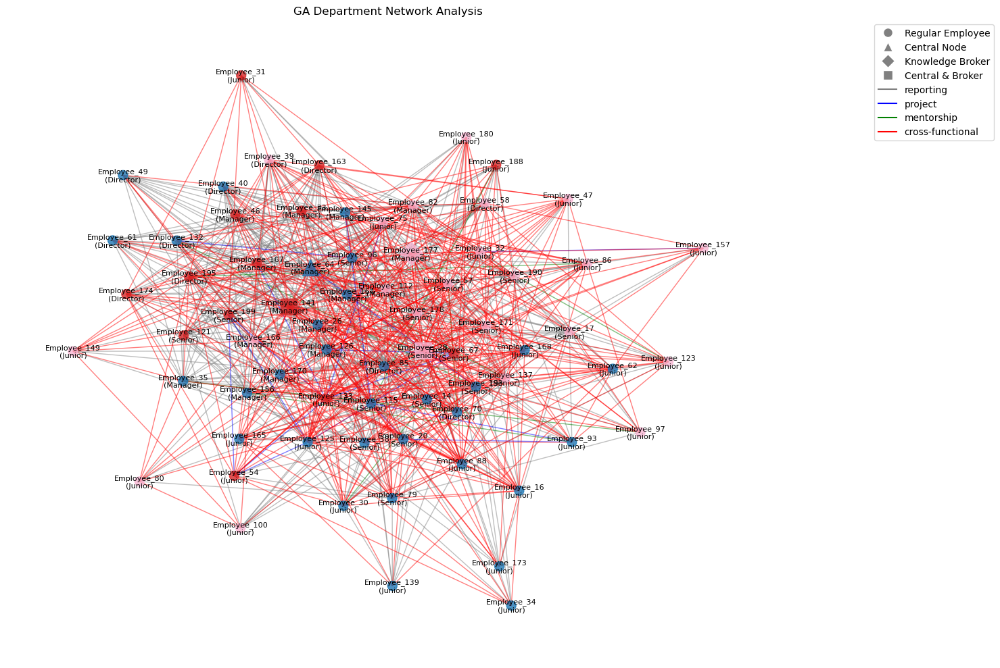


GA Department Analysis:

Central Nodes (High Degree Centrality):
Employee_64 - Role: Manager - Years: 12
Employee_28 - Role: Senior - Years: 11
Employee_141 - Role: Manager - Years: 13

Knowledge Brokers (High Betweenness Centrality):
Employee_177 - Role: Manager - Years: 20
Employee_28 - Role: Senior - Years: 11
Employee_141 - Role: Manager - Years: 13

Cluster Analysis:

Cluster 0 - Size: 32
Role Distribution:
  Junior: 11 (34.4%)
  Manager: 8 (25.0%)
  Senior: 7 (21.9%)
  Director: 6 (18.8%)

Cluster 2 - Size: 24
Role Distribution:
  Junior: 11 (45.8%)
  Senior: 7 (29.2%)
  Manager: 4 (16.7%)
  Director: 2 (8.3%)

Cluster 1 - Size: 14
Role Distribution:
  Junior: 4 (28.6%)
  Manager: 4 (28.6%)
  Director: 3 (21.4%)
  Senior: 3 (21.4%)

Relationship Type Analysis:
Reporting: 391
Project: 17
Mentorship: 9
Cross-functional: 439


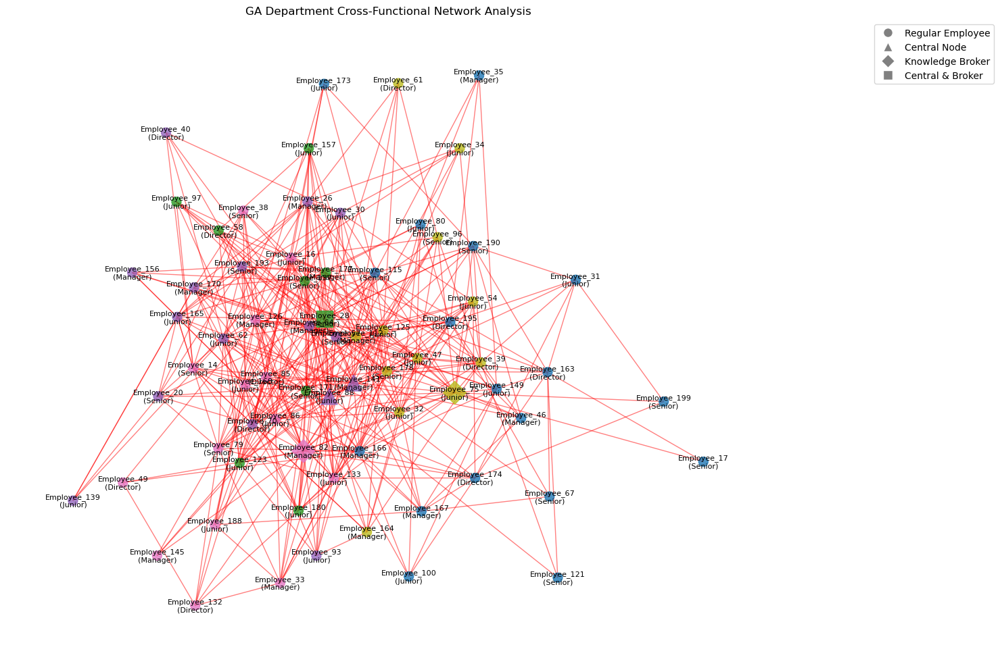


GA Department Cross-Functional Network Analysis:

Central Nodes (High Degree Centrality):
Employee_88 - Role: Junior - Years: 1 - Skills: Technical, Leadership, Communication
Employee_28 - Role: Senior - Years: 11 - Skills: Communication, Analytical, Leadership
Employee_141 - Role: Manager - Years: 13 - Skills: Technical, Leadership, Creative

Knowledge Brokers (High Betweenness Centrality):
Employee_82 - Role: Manager - Years: 3 - Skills: Communication, Analytical, Leadership
Employee_75 - Role: Junior - Years: 3 - Skills: Creative, Leadership, Communication
Employee_28 - Role: Senior - Years: 11 - Skills: Communication, Analytical, Leadership

Cluster Analysis:

Cluster 0 - Size: 18
Role Distribution:
  Senior: 6 (33.3%)
  Junior: 5 (27.8%)
  Manager: 4 (22.2%)
  Director: 3 (16.7%)
Skill Distribution:
  Creative: 16 (88.9%)
  Analytical: 6 (33.3%)
  Communication: 4 (22.2%)
  Technical: 1 (5.6%)

Cluster 2 - Size: 16
Role Distribution:
  Junior: 6 (37.5%)
  Manager: 5 (31.2%)
  Sen

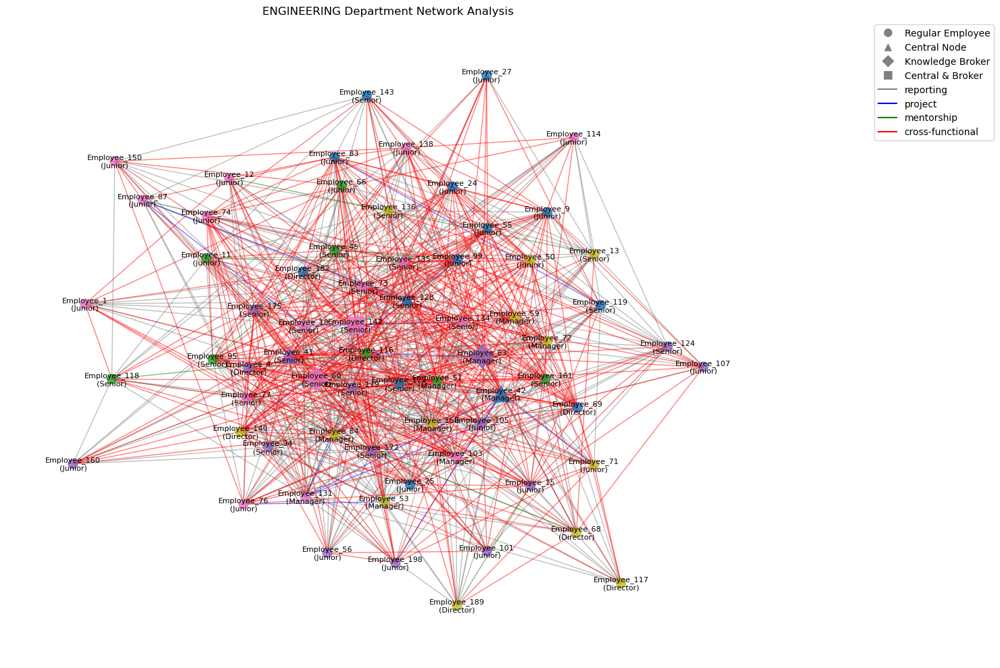


ENGINEERING Department Analysis:

Central Nodes (High Degree Centrality):
Employee_41 - Role: Senior - Years: 16
Employee_42 - Role: Manager - Years: 8
Employee_142 - Role: Senior - Years: 12

Knowledge Brokers (High Betweenness Centrality):
Employee_60 - Role: Senior - Years: 6
Employee_142 - Role: Senior - Years: 12
Employee_63 - Role: Manager - Years: 8

Cluster Analysis:

Cluster 3 - Size: 17
Role Distribution:
  Junior: 8 (47.1%)
  Senior: 7 (41.2%)
  Manager: 2 (11.8%)

Cluster 2 - Size: 15
Role Distribution:
  Junior: 7 (46.7%)
  Senior: 6 (40.0%)
  Director: 1 (6.7%)
  Manager: 1 (6.7%)

Cluster 0 - Size: 14
Role Distribution:
  Junior: 7 (50.0%)
  Senior: 4 (28.6%)
  Director: 2 (14.3%)
  Manager: 1 (7.1%)

Cluster 4 - Size: 13
Role Distribution:
  Manager: 5 (38.5%)
  Director: 4 (30.8%)
  Senior: 2 (15.4%)
  Junior: 2 (15.4%)

Cluster 1 - Size: 8
Role Distribution:
  Senior: 4 (50.0%)
  Junior: 2 (25.0%)
  Manager: 1 (12.5%)
  Director: 1 (12.5%)

Relationship Type Analysis

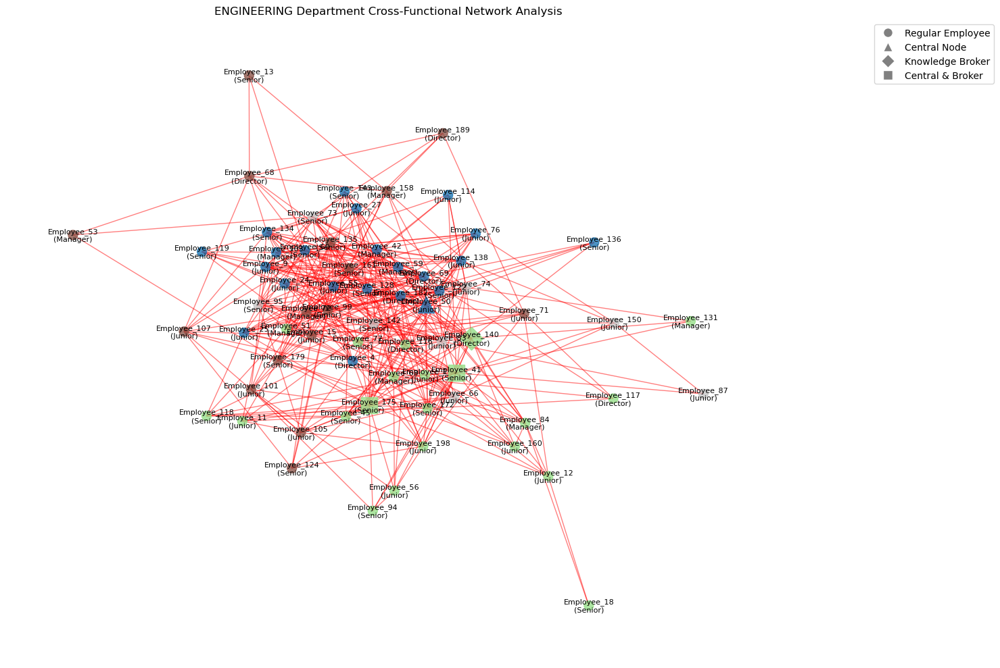


ENGINEERING Department Cross-Functional Network Analysis:

Central Nodes (High Degree Centrality):
Employee_41 - Role: Senior - Years: 16 - Skills: Leadership, Technical, Communication
Employee_50 - Role: Junior - Years: 19 - Skills: Creative, Analytical, Technical
Employee_175 - Role: Senior - Years: 10 - Skills: Leadership, Technical, Communication

Knowledge Brokers (High Betweenness Centrality):
Employee_41 - Role: Senior - Years: 16 - Skills: Leadership, Technical, Communication
Employee_140 - Role: Director - Years: 3 - Skills: Communication, Technical, Analytical
Employee_175 - Role: Senior - Years: 10 - Skills: Leadership, Technical, Communication

Cluster Analysis:

Cluster 0 - Size: 22
Role Distribution:
  Junior: 9 (40.9%)
  Senior: 7 (31.8%)
  Director: 3 (13.6%)
  Manager: 3 (13.6%)
Skill Distribution:
  Creative: 20 (90.9%)
  Technical: 8 (36.4%)
  Analytical: 5 (22.7%)
  Leadership: 5 (22.7%)
  Communication: 2 (9.1%)

Cluster 1 - Size: 21
Role Distribution:
  Senior: 8

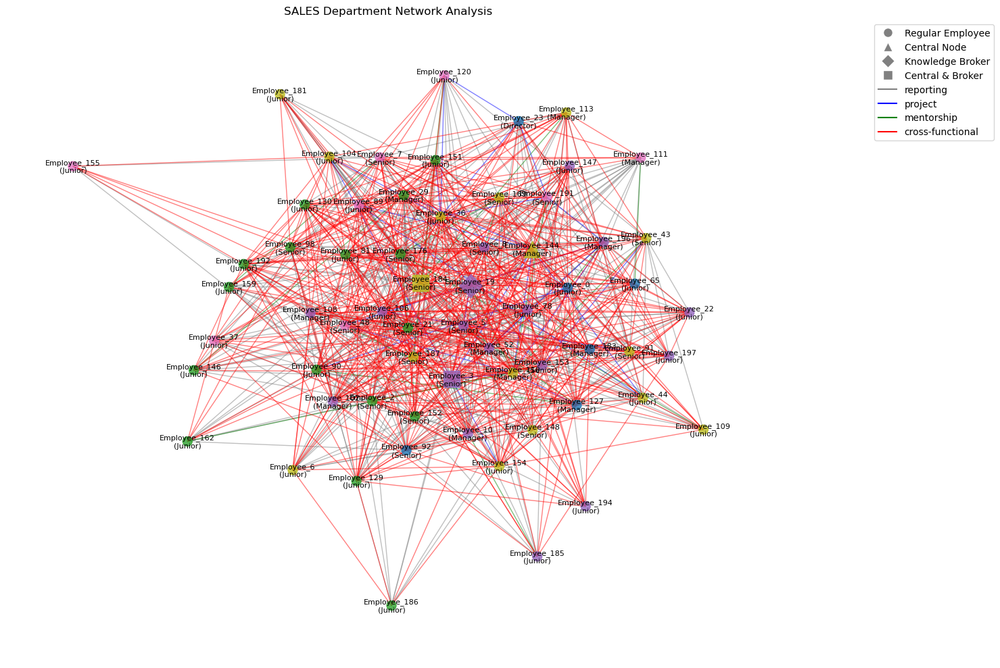


SALES Department Analysis:

Central Nodes (High Degree Centrality):
Employee_144 - Role: Manager - Years: 14
Employee_3 - Role: Senior - Years: 20
Employee_184 - Role: Senior - Years: 1

Knowledge Brokers (High Betweenness Centrality):
Employee_184 - Role: Senior - Years: 1
Employee_3 - Role: Senior - Years: 20
Employee_19 - Role: Senior - Years: 3

Cluster Analysis:

Cluster 2 - Size: 17
Role Distribution:
  Junior: 7 (41.2%)
  Senior: 5 (29.4%)
  Manager: 5 (29.4%)

Cluster 1 - Size: 16
Role Distribution:
  Junior: 10 (62.5%)
  Senior: 5 (31.2%)
  Manager: 1 (6.2%)

Cluster 4 - Size: 16
Role Distribution:
  Junior: 7 (43.8%)
  Senior: 6 (37.5%)
  Manager: 3 (18.8%)

Cluster 3 - Size: 8
Role Distribution:
  Junior: 4 (50.0%)
  Senior: 3 (37.5%)
  Manager: 1 (12.5%)

Cluster 0 - Size: 6
Role Distribution:
  Junior: 2 (33.3%)
  Manager: 2 (33.3%)
  Director: 1 (16.7%)
  Senior: 1 (16.7%)

Relationship Type Analysis:
Reporting: 297
Project: 25
Mentorship: 19
Cross-functional: 486


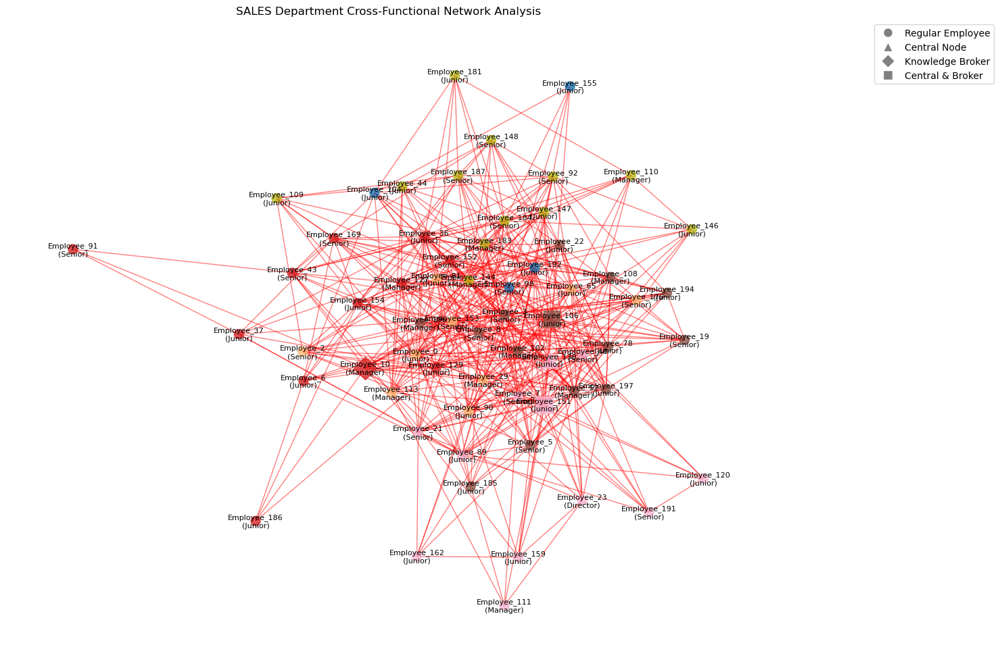


SALES Department Cross-Functional Network Analysis:

Central Nodes (High Degree Centrality):
Employee_151 - Role: Junior - Years: 16 - Skills: Creative, Leadership, Analytical
Employee_106 - Role: Junior - Years: 20 - Skills: Technical, Analytical, Creative
Employee_130 - Role: Junior - Years: 19 - Skills: Technical, Analytical, Leadership

Knowledge Brokers (High Betweenness Centrality):
Employee_106 - Role: Junior - Years: 20 - Skills: Technical, Analytical, Creative
Employee_10 - Role: Manager - Years: 12 - Skills: Technical, Creative, Leadership
Employee_151 - Role: Junior - Years: 16 - Skills: Creative, Leadership, Analytical

Cluster Analysis:

Cluster 3 - Size: 14
Role Distribution:
  Junior: 6 (42.9%)
  Senior: 4 (28.6%)
  Manager: 4 (28.6%)
Skill Distribution:
  Technical: 14 (100.0%)
  Analytical: 6 (42.9%)
  Creative: 5 (35.7%)
  Leadership: 3 (21.4%)
  Communication: 3 (21.4%)

Cluster 2 - Size: 12
Role Distribution:
  Junior: 6 (50.0%)
  Senior: 4 (33.3%)
  Manager: 2 (16

In [61]:
import networkx as nx
import matplotlib.pyplot as plt
import random
from community import community_louvain
from matplotlib.lines import Line2D

def generate_employees(num_employees):
    departments = ['GA', 'SALES', 'ENGINEERING']
    roles = ['Junior', 'Senior', 'Manager', 'Director']
    skills = ['Technical', 'Creative', 'Analytical', 'Communication', 'Leadership']
    employees = []
    for i in range(num_employees):
        employee = {
            'id': i,
            'name': f'Employee_{i}',
            'department': random.choice(departments),
            'years_experience': random.randint(1, 20),
            'role': random.choices(roles, weights=[4, 3, 2, 1])[0],  # More juniors, fewer directors
            'skills': random.sample(skills, k=random.randint(1, 3))  # Each employee has 1-3 skills
        }
        employees.append(employee)
    return employees

def create_company_graph(employees):
    G = nx.Graph()
    
    for employee in employees:
        G.add_node(employee['id'], **employee)
    
    # Create hierarchical structure
    roles = {'Director': [], 'Manager': [], 'Senior': [], 'Junior': []}
    departments = set(employee['department'] for employee in employees)
    
    for employee in employees:
        roles[employee['role']].append(employee)
    
    # Reporting relationships
    for director in roles['Director']:
        for manager in roles['Manager']:
            if director['department'] == manager['department']:
                G.add_edge(director['id'], manager['id'], relationship='reporting')
    
    for manager in roles['Manager']:
        for senior in roles['Senior']:
            if manager['department'] == senior['department'] and random.random() < 0.6:  # 60% chance of reporting to this manager
                G.add_edge(manager['id'], senior['id'], relationship='reporting')
    
    for senior in roles['Senior']:
        for junior in roles['Junior']:
            if senior['department'] == junior['department'] and random.random() < 0.4:  # 40% chance of reporting to this senior
                G.add_edge(senior['id'], junior['id'], relationship='reporting')
    
    # Project collaborations
    num_projects = len(employees) // 10  # Assume one project for every 10 employees
    for _ in range(num_projects):
        project_team = random.sample(employees, k=random.randint(3, 7))
        for i in range(len(project_team)):
            for j in range(i+1, len(project_team)):
                G.add_edge(project_team[i]['id'], project_team[j]['id'], relationship='project')
    
    # Mentorship program
    mentors = roles['Senior'] + roles['Manager'] + roles['Director']
    mentees = roles['Junior'] + roles['Senior']
    for mentee in mentees:
        if random.random() < 0.4:  # 40% chance of having a mentor
            potential_mentors = [m for m in mentors if m['department'] == mentee['department'] and m['id'] != mentee['id']]
            if potential_mentors:
                mentor = random.choice(potential_mentors)
                G.add_edge(mentor['id'], mentee['id'], relationship='mentorship')
    
    # Cross-functional teams (based on skills)
    for skill in ['Technical', 'Creative', 'Analytical', 'Communication', 'Leadership']:
        skilled_employees = [e for e in employees if skill in e['skills']]
        if len(skilled_employees) > 1:
            for i in range(len(skilled_employees)):
                for j in range(i+1, len(skilled_employees)):
                    if random.random() < 0.3:  # 30% chance of connection within skill group
                        G.add_edge(skilled_employees[i]['id'], skilled_employees[j]['id'], relationship='cross-functional')
    
    return G
def create_department_graph(employees, target_department):
    dept_employees = [e for e in employees if e['department'] == target_department]
    G = nx.Graph()
    
    for employee in dept_employees:
        G.add_node(employee['id'], **employee)
    
    # Create hierarchical structure
    roles = {'Director': [], 'Manager': [], 'Senior': [], 'Junior': []}
    for employee in dept_employees:
        roles[employee['role']].append(employee)
    
    # Reporting relationships
    for director in roles['Director']:
        for manager in roles['Manager']:
            G.add_edge(director['id'], manager['id'], relationship='reporting')
    
    for manager in roles['Manager']:
        for senior in random.sample(roles['Senior'], min(len(roles['Senior']), 3)):
            G.add_edge(manager['id'], senior['id'], relationship='reporting')
    
    for senior in roles['Senior']:
        for junior in random.sample(roles['Junior'], min(len(roles['Junior']), 5)):
            G.add_edge(senior['id'], junior['id'], relationship='reporting')
    
    # Project collaborations
    num_projects = len(dept_employees) // 5  # Assume one project for every 5 employees
    for _ in range(num_projects):
        project_team = random.sample(dept_employees, k=random.randint(3, 7))
        for i in range(len(project_team)):
            for j in range(i+1, len(project_team)):
                G.add_edge(project_team[i]['id'], project_team[j]['id'], relationship='project')
    
    # Mentorship program
    mentors = roles['Senior'] + roles['Manager'] + roles['Director']
    mentees = roles['Junior'] + roles['Senior']
    for mentee in mentees:
        if random.random() < 0.4:  # 40% chance of having a mentor
            mentor = random.choice(mentors)
            if mentor['id'] != mentee['id']:
                G.add_edge(mentor['id'], mentee['id'], relationship='mentorship')
    
    # Cross-functional teams (based on skills)
    for skill in ['Technical', 'Creative', 'Analytical', 'Communication', 'Leadership']:
        skilled_employees = [e for e in dept_employees if skill in e['skills']]
        if len(skilled_employees) > 1:
            for i in range(len(skilled_employees)):
                for j in range(i+1, len(skilled_employees)):
                    if random.random() < 0.3:  # 30% chance of connection within skill group
                        G.add_edge(skilled_employees[i]['id'], skilled_employees[j]['id'], relationship='cross-functional')
    
    return G

def analyze_and_visualize_department_network(G, department):
    if len(G) == 0:
        print(f"No employees found in the {department} department.")
        return

    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    
    central_nodes = set(sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:3])
    knowledge_brokers = set(sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:3])
    
    partition = community_louvain.best_partition(G)
    
    num_clusters = len(set(partition.values()))
    color_map = plt.cm.get_cmap('tab20')
    node_colors = [color_map(partition[node] / num_clusters) for node in G.nodes()]
    
    node_sizes = []
    node_shapes = []
    for node in G.nodes():
        size = 300 if node in central_nodes or node in knowledge_brokers else 100
        node_sizes.append(size)
        if node in central_nodes and node in knowledge_brokers:
            node_shapes.append('s')  # square for both
        elif node in central_nodes:
            node_shapes.append('^')  # triangle for central nodes
        elif node in knowledge_brokers:
            node_shapes.append('D')  # diamond for knowledge brokers
        else:
            node_shapes.append('o')  # circle for regular nodes
    
    pos = nx.spring_layout(G, k=0.5, iterations=50)
    plt.figure(figsize=(15, 10))
    
    # Draw nodes
    for shape in set(node_shapes):
        node_list = [node for node, node_shape in zip(G.nodes(), node_shapes) if node_shape == shape]
        nx.draw_networkx_nodes(G, pos, nodelist=node_list, node_color=[node_colors[list(G.nodes()).index(n)] for n in node_list],
                               node_size=[node_sizes[list(G.nodes()).index(n)] for n in node_list], node_shape=shape, alpha=0.8)
    
    # Draw edges with different colors for different relationships
    edge_colors = {'reporting': 'gray', 'project': 'blue', 'mentorship': 'green', 'cross-functional': 'red'}
    for relationship, color in edge_colors.items():
        edges = [(u, v) for (u, v, d) in G.edges(data=True) if d['relationship'] == relationship]
        nx.draw_networkx_edges(G, pos, edgelist=edges, edge_color=color, alpha=0.5)
    
    labels = {node: f"{G.nodes[node]['name']}\n({G.nodes[node]['role']})" for node in G.nodes()}
    nx.draw_networkx_labels(G, pos, labels, font_size=8)
    
    plt.title(f"{department} Department Network Analysis")
    
    # Create legend for nodes and edges
    node_legend = [
        Line2D([0], [0], marker='o', color='w', label='Regular Employee', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='^', color='w', label='Central Node', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='D', color='w', label='Knowledge Broker', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='s', color='w', label='Central & Broker', markerfacecolor='gray', markersize=10)
    ]
    edge_legend = [Line2D([0], [0], color=color, label=relationship) for relationship, color in edge_colors.items()]
    plt.legend(handles=node_legend + edge_legend, loc='upper right', bbox_to_anchor=(1.3, 1))
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    print(f"\n{department} Department Analysis:")
    print("\nCentral Nodes (High Degree Centrality):")
    for node in central_nodes:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']}")
    
    print("\nKnowledge Brokers (High Betweenness Centrality):")
    for node in knowledge_brokers:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']}")
    
    print("\nCluster Analysis:")
    cluster_sizes = {}
    cluster_roles = {}
    for node, cluster in partition.items():
        cluster_sizes[cluster] = cluster_sizes.get(cluster, 0) + 1
        role = G.nodes[node]['role']
        if cluster not in cluster_roles:
            cluster_roles[cluster] = {}
        cluster_roles[cluster][role] = cluster_roles[cluster].get(role, 0) + 1
    
    for cluster, size in sorted(cluster_sizes.items(), key=lambda x: x[1], reverse=True):
        print(f"\nCluster {cluster} - Size: {size}")
        print("Role Distribution:")
        for role, count in sorted(cluster_roles[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {role}: {count} ({count/size*100:.1f}%)")

    # Relationship type analysis
    relationship_counts = {rel: 0 for rel in edge_colors.keys()}
    for _, _, data in G.edges(data=True):
        relationship_counts[data['relationship']] += 1
    
    print("\nRelationship Type Analysis:")
    for rel, count in relationship_counts.items():
        print(f"{rel.capitalize()}: {count}")
def analyze_and_visualize_cross_functional_network(G, department):
    if len(G) == 0:
        print(f"No employees found in the {department} department.")
        return

    # Create a subgraph with only cross-functional edges
    cross_functional_edges = [(u, v) for (u, v, d) in G.edges(data=True) if d['relationship'] == 'cross-functional']
    G_cross = G.edge_subgraph(cross_functional_edges)

    if len(G_cross) == 0:
        print(f"No cross-functional relationships found in the {department} department.")
        return

    degree_centrality = nx.degree_centrality(G_cross)
    betweenness_centrality = nx.betweenness_centrality(G_cross)
    
    central_nodes = set(sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:3])
    knowledge_brokers = set(sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:3])
    
    partition = community_louvain.best_partition(G_cross)
    
    num_clusters = len(set(partition.values()))
    color_map = plt.cm.get_cmap('tab20')
    node_colors = [color_map(partition[node] / num_clusters) for node in G_cross.nodes()]
    
    node_sizes = []
    node_shapes = []
    for node in G_cross.nodes():
        size = 300 if node in central_nodes or node in knowledge_brokers else 100
        node_sizes.append(size)
        if node in central_nodes and node in knowledge_brokers:
            node_shapes.append('s')  # square for both
        elif node in central_nodes:
            node_shapes.append('^')  # triangle for central nodes
        elif node in knowledge_brokers:
            node_shapes.append('D')  # diamond for knowledge brokers
        else:
            node_shapes.append('o')  # circle for regular nodes
    
    pos = nx.spring_layout(G_cross, k=0.5, iterations=50)
    plt.figure(figsize=(15, 10))
    
    # Draw nodes
    for shape in set(node_shapes):
        node_list = [node for node, node_shape in zip(G_cross.nodes(), node_shapes) if node_shape == shape]
        nx.draw_networkx_nodes(G_cross, pos, nodelist=node_list, node_color=[node_colors[list(G_cross.nodes()).index(n)] for n in node_list],
                               node_size=[node_sizes[list(G_cross.nodes()).index(n)] for n in node_list], node_shape=shape, alpha=0.8)
    
    # Draw edges
    nx.draw_networkx_edges(G_cross, pos, edge_color='red', alpha=0.5)
    
    labels = {node: f"{G.nodes[node]['name']}\n({G.nodes[node]['role']})" for node in G_cross.nodes()}
    nx.draw_networkx_labels(G_cross, pos, labels, font_size=8)
    
    plt.title(f"{department} Department Cross-Functional Network Analysis")
    
    # Create legend for nodes
    node_legend = [
        Line2D([0], [0], marker='o', color='w', label='Regular Employee', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='^', color='w', label='Central Node', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='D', color='w', label='Knowledge Broker', markerfacecolor='gray', markersize=10),
        Line2D([0], [0], marker='s', color='w', label='Central & Broker', markerfacecolor='gray', markersize=10)
    ]
    plt.legend(handles=node_legend, loc='upper right', bbox_to_anchor=(1.3, 1))
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    print(f"\n{department} Department Cross-Functional Network Analysis:")
    print("\nCentral Nodes (High Degree Centrality):")
    for node in central_nodes:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']} - Skills: {', '.join(G.nodes[node]['skills'])}")
    
    print("\nKnowledge Brokers (High Betweenness Centrality):")
    for node in knowledge_brokers:
        print(f"{G.nodes[node]['name']} - Role: {G.nodes[node]['role']} - Years: {G.nodes[node]['years_experience']} - Skills: {', '.join(G.nodes[node]['skills'])}")
    
    print("\nCluster Analysis:")
    cluster_sizes = {}
    cluster_roles = {}
    cluster_skills = {}
    for node, cluster in partition.items():
        cluster_sizes[cluster] = cluster_sizes.get(cluster, 0) + 1
        role = G.nodes[node]['role']
        skills = G.nodes[node]['skills']
        if cluster not in cluster_roles:
            cluster_roles[cluster] = {}
            cluster_skills[cluster] = {}
        cluster_roles[cluster][role] = cluster_roles[cluster].get(role, 0) + 1
        for skill in skills:
            cluster_skills[cluster][skill] = cluster_skills[cluster].get(skill, 0) + 1
    
    for cluster, size in sorted(cluster_sizes.items(), key=lambda x: x[1], reverse=True):
        print(f"\nCluster {cluster} - Size: {size}")
        print("Role Distribution:")
        for role, count in sorted(cluster_roles[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {role}: {count} ({count/size*100:.1f}%)")
        print("Skill Distribution:")
        for skill, count in sorted(cluster_skills[cluster].items(), key=lambda x: x[1], reverse=True):
            print(f"  {skill}: {count} ({count/size*100:.1f}%)")

    print("\nNetwork Statistics:")
    print(f"Number of nodes: {G_cross.number_of_nodes()}")
    print(f"Number of edges: {G_cross.number_of_edges()}")
    print(f"Average clustering coefficient: {nx.average_clustering(G_cross):.3f}")
    print(f"Network density: {nx.density(G_cross):.3f}")

# Main execution
# num_employees = 200
# employees = generate_employees(num_employees)

# # Select a department for analysis
# target_department = 'ENGINEERING'  # You can change this to any department

# G = create_department_graph(employees, target_department)
# analyze_and_visualize_cross_functional_network(G, target_department)
# # Main execution
# #num_employees = 200
# #employees = generate_employees(num_employees)

# # Select a department for analysis
# #target_department = 'ENGINEERING'  # You can change this to any department

# #G = create_department_graph(employees, target_department)
# analyze_and_visualize_department_network(G, target_department)

num_employees = 200
employees = generate_employees(num_employees)

# Create graph for all departments
G = create_company_graph(employees)

# Analyze and visualize the entire company network
analyze_and_visualize_department_network(G, "All Departments")

# If you want to analyze cross-functional relationships across the entire company
analyze_and_visualize_cross_functional_network(G, "All Departments")

# If you still want to analyze individual departments, you can create subgraphs
for department in set(employee['department'] for employee in employees):
    department_employees = [e['id'] for e in employees if e['department'] == department]
    G_dept = G.subgraph(department_employees)
    analyze_and_visualize_department_network(G_dept, department)
    analyze_and_visualize_cross_functional_network(G_dept, department)

In [65]:
import torch
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.nn import GCNConv
from torch_geometric.loader import DataLoader
import numpy as np

# Synthesize employee data
num_employees = 100
np.random.seed(42)

# Node features: age, tenure, salary
x = torch.tensor(np.random.rand(num_employees, 3), dtype=torch.float)

# Edge index: randomly connect employees (you might want a more structured approach in reality)
edge_index = torch.tensor(np.random.choice(num_employees, (2, 500)), dtype=torch.long)

# Target: job satisfaction (0: low, 1: medium, 2: high)
y = torch.tensor(np.random.choice(3, num_employees), dtype=torch.long)

# Create PyTorch Geometric data object
data = Data(x=x, edge_index=edge_index, y=y)

# Define the GNN model
class GCN(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = GCNConv(3, 16)
        self.conv2 = GCNConv(16, 3)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)

# Initialize the model
model = GCN()

# Training function
def train():
    model.train()
    optimizer.zero_grad()
    out = model(data.x, data.edge_index)
    loss = F.nll_loss(out[data.train_mask], data.y[data.train_mask])
    loss.backward()
    optimizer.step()
    return loss

# Testing function
def test():
    model.eval()
    out = model(data.x, data.edge_index)
    pred = out.argmax(dim=1)
    correct = pred[data.test_mask] == data.y[data.test_mask]
    acc = int(correct.sum()) / int(data.test_mask.sum())
    return acc

# Split data into train and test sets
num_train = int(0.8 * num_employees)
train_mask = torch.zeros(num_employees, dtype=torch.bool)
train_mask[:num_train] = True
test_mask = ~train_mask
data.train_mask = train_mask
data.test_mask = test_mask

# Initialize optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# Train the model
for epoch in range(200):
    loss = train()
    if epoch % 10 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item():.4f}')

# Evaluate the model
test_acc = test()
print(f'Test Accuracy: {test_acc:.4f}')

# Make predictions for new employees
def predict_satisfaction(new_employee_features, new_employee_connections):
    model.eval()
    new_x = torch.tensor(new_employee_features, dtype=torch.float).unsqueeze(0)
    new_edge_index = torch.tensor(new_employee_connections, dtype=torch.long)
    with torch.no_grad():
        out = model(new_x, new_edge_index)
    pred = out.argmax(dim=1).item()
    satisfaction_levels = ['Low', 'Medium', 'High']
    return satisfaction_levels[pred]

# Example usage
new_employee_features = [0.5, 0.7, 0.6]  # age, tenure, salary (normalized)
new_employee_connections = [[0], [5, 10, 15]]  # connected to employees 5, 10, and 15
predicted_satisfaction = predict_satisfaction(new_employee_features, new_employee_connections)
print(f'Predicted job satisfaction: {predicted_satisfaction}')

ModuleNotFoundError: No module named 'torch_geometric'

In [66]:
!pip3 install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu124

^C
